# Retrievals over the Amazon basin

Here real GOME-2 data is used to retrieve atmospheric parameters, as well as clf, a, p and DASF. We use the Bayesian method for retrievals as described in WB4.

In [2]:
# path to EPS file to read
e_fn = '/home/malapradej/Documents/PhD_UCL/Data/GOME-2/l1b/2007/01/GOME_xxx_1B_M02_20070125124939Z_20070125143057Z_R_O_20120209112017Z'

# the latitude and longitude of the rectangle for which we want the data
# format is top left and bottom right
lat_tl = 3.0
lon_tl = -70.0
lat_br = -11.0
lon_br = -52.0

In [2]:
# don't run this again if we already have a pickled dict file with the data....

"""
This runs the coda package to get the data in EPS format to a pickle file which 
has been QA'ed to remove bad data.
The script creates a pickled dictionary file per orbit with all DASF values, 
observation data and QA data. 
The script requires CODA library for python to be installed.
To run the script certain directories need to be set up in advance. They include
directories created manualy or during installation of CODA library. The following
directories need to be created and amended in the code below:
variable            usual path can be amended
========            =========================
path_coda           /usr/local/share/coda/definitions/
path_dasf           path for output *.p pickled dictionary DASF files.
"""
import sys
import os
# sets the CODA definition file path. This is used by CODA to understand the
# format of the EPS file.
path_coda = '/usr/local/share/coda/definitions/'
if not(os.path.isdir(path_coda)):
    text = 'The path %s does not exist.' % path_coda
    raise IOError(text)
os.putenv('CODA_DEFINITION', path_coda)
import coda
import numpy as np
import time
import subprocess
from scipy.interpolate import interp1d
from scipy import stats
import pickle

def mmol_Watt(mmols, wl):
    '''A function that converts a measurement in micro mol photons to Watts. 
    This is usefull in flux calculations. 
    Input: mmols - mmols at wavelength, wl - wavelength in nm.
    Output: Watts    
    The conversion is based on the examples in 
    http://5e.plantphys.net/article.php?ch=t&id=131
    '''
    E = 1.988e-16 / wl
    micro = 10.**-6
    avo = 6.02e23
    # convert micromoles (umol) per m2 per sec to W per m2
    Watt = np.multiply(mmols*micro*avo, E)
    return Watt
    
def phot_Watt(photons, wl):
    '''Function to convert radiant flux from photons / (cm2 s nm) to 
    Watt / m2.
    Input: photons - photons at wavelenght, wl - wavelength in nm.
    Output: Watt - Watt / m2
    '''
    # convert to m^2 from of cm^2
    photons *= 10000.
    # convert the solar irradiance from photons to mols
    avo = 6.02e23
    mols = photons / avo 
    # convert to mmols
    mmols = mols * 1.0e6
    Watt = mmol_Watt(mmols, wl)
    return Watt


def interpolate(rc, ic):
    '''
    Function that interpolates a solar irradiance spectrum to the same
    wavelengths as the radiance spectrum. This is due to slight differences
    between the radiance and irradiance wavelength intervals.
    This function does not get passed the radiance and irradiance arrays but
    only the indexes of the radiance wavelenght at which to interpolate, and 
    the index to the upper irradiance wavelength used in the interpolation.
    Input: rc - radiance index, ic - irradiance index.
    Output: inter_irr - interpolated irradiance value.
    '''
    lam_int = sol_lam[ic] - sol_lam[ic-1]
    step = rad_lam[rc] - sol_lam[ic-1]
    frac = step / lam_int
    irr_int = sol_irr[ic] - sol_irr[ic-1]
    inter_irr = sol_irr[ic-1] + frac * irr_int
    return inter_irr


# range of forward scans out of [0:31]
forw_scans = np.arange(24)

# cloud fraction threshold
cloud_thresh = 0.99

# solar zenith angle threshold
sol_zen_lim = 80.0

# satelite zenith angle threshold
sat_zen_lim = 70.0

# lower and upper limits of the red-edge
edge_lower = 680.
# TRY to remove the water vapour absorption lines starting at about 710nm
edge_upper = 755.

# opening the file
ef = coda.open(e_fn)

# creates a base name without extension used in rest of code
base_fn = os.path.splitext(e_fn)[0] # removes any extension from path
base_fn = os.path.basename(base_fn) # selects only filename
base_fn = '%s_EPS_QAd' % base_fn

# path to DASF data to be saved
path_dasf = '/home/malapradej/Documents/PhD_UCL/Data/GOME-2/DASF'
if not(os.path.exists(path_dasf)):
    text = 'The path %s does not exist.' % path_dasf
    raise IOError(text)

# reading solar wavelength and irradiance in band 4
sol_lam = coda.fetch(ef, 'VIADR_SMR', 0, 'LAMBDA_SMR')[3]
n_sol_lam = len(sol_lam)
sol_irr = coda.fetch(ef, 'VIADR_SMR', 0, 'SMR')[3]
sol_irr = phot_Watt(sol_irr, sol_lam)

# reading total number of scans
n_mdr = coda.fetch(ef, 'MPHR', 'TOTAL_MDR')

# list for point lat, lon, radiance, irradiance, spectrum etc.
Lat = []
Lon = []
Lam = []
Rad = []
Irr = []
Ref_toa = []
Time = []
Alt = []
Cloud_frac = []
Sol_zen = []
Sol_azi = []
Sat_zen = []
Sat_azi = []

for cur_scan in np.arange(n_mdr):
    txt = 'current scan line is %d out of %d scans.' % (cur_scan+1, n_mdr)
    sys.stdout.write('\r' + str(txt) + ' ' * 20)
    sys.stdout.flush()
    #print 'current scan line is %d out of %d scans.' % (cur_scan+1, n_mdr)
    # is this an Earthshine scan, not calibration etc, then skip this scan?
    es = coda.get_field_available(ef, 'MDR', cur_scan, 'Earthshine')
    if not(es):
        continue
    
    # is this a nadir scan (0), not calibration etc?
    nad = coda.fetch(ef, 'MDR', cur_scan, 'Earthshine', 'OBSERVATION_MODE')
    nad = True if nad == 0 else False
    
    # QA of scan.
    # is scan degraded due to instrument degradation?
    bad_ins = coda.fetch(ef, 'MDR', cur_scan, 'Earthshine', 'DEGRADED_INSTR_MDR')
    bad_ins = True if bad_ins == 1 else False
    # is scan degraded due to processing degradation?
    bad_pro = coda.fetch(ef, 'MDR', cur_scan, 'Earthshine', 'DEGRADED_PROC_MDR')
    bad_pro = True if bad_pro == 1 else False
    # if some processing degraded data is this critical for our purpose?
    if bad_pro:
        # is it due to missing data which is not ok, or old calibration data
        # which is still ok?
        f_miss = coda.fetch(ef, 'MDR', cur_scan, 'Earthshine', 'PCD_BASIC',\
            'F_MISS')
        bad_pro = True if f_miss != 0 else False

    # is this calibrated radiance (0) or reflectance (1)?
    rad_ref = coda.fetch(ef, 'MDR', cur_scan, 'Earthshine', 'OUTPUT_SELECTION')
    rad_ref = True if rad_ref == 0 else False
    
    # if any above conditions are not met skip this scan
    if not(es) or not(nad) or bad_ins or bad_pro or not(rad_ref):
        continue
        
    for cur_pnt in forw_scans:  
        # did cloud fraction retrieval work, if not skip point?
        cf = coda.fetch(ef, 'MDR', cur_scan, 'Earthshine', 'CLOUD', 'FAIL_FLAG',\
            cur_pnt)
        cf = True if cf == 0 else False
        if not(cf):
            continue
        
        # is parameter for cloud fraction (0) not snow/ice (1), if not skip point?
        cf = coda.fetch(ef, 'MDR', cur_scan, 'Earthshine', 'CLOUD', 'FIT_MODE',\
            cur_pnt)
        cf = True if cf == 0 else False
        if not(cf):
            continue
        
        # reading cloud fraction, and if > threshold skip point
        cf = coda.fetch(ef, 'MDR', cur_scan, 'Earthshine', 'CLOUD', 'FIT_2',\
            cur_pnt)
        if cf > cloud_thresh:
            continue
        
        # reading solar zenith angle if greater than threshold skip point
        sol_zen = coda.fetch(ef, 'MDR', cur_scan, 'Earthshine', 'GEO_EARTH',\
            'SOLAR_ZENITH', [1, cur_pnt])
        if sol_zen > sol_zen_lim:
            continue
        
        # satellite zenith angle
        sat_zen = coda.fetch(ef, 'MDR', cur_scan, 'Earthshine', 'GEO_EARTH',\
            'SAT_ZENITH', [1, cur_pnt])
        if sat_zen > sat_zen_lim:
            continue
        
        # number of spectral records in band 4, and create point array for radiance
        n_spec = coda.fetch(ef, 'MDR', cur_scan, 'Earthshine', 'REC_LENGTH', 5)
        rad_arr = np.zeros(n_spec)
        
        # placeholder for dud spectrum. Check against this after loop
        dud = False
        
        # reading coordinates
        lat, lon  = coda.fetch(ef, 'MDR', cur_scan, 'Earthshine', 'GEO_EARTH',\
            'CENTRE', cur_pnt)
        
        
        # TEMPORARY halt to see Amazon....
        if lat < lat_tl and lon > lon_tl and lat > lat_br and lon < lon_br:
            pass
        else:
            continue
        
        for cur_spc in np.arange(n_spec):
            # reading radiance, error and stokes fraction
            rad, rad_e, st_f  = coda.fetch(ef, 'MDR', cur_scan, 'Earthshine', 'BAND_4',\
                [cur_pnt,cur_spc])
            
            # is the current point radiance nan or negative, ie ocean etc, then
            # skip the whole point?
            dud = True if rad < 0. or np.isnan(rad) else False
            if dud:
                break
            
            rad_arr[cur_spc] = rad
            
        # skip point if dud in radiance array
        if dud:
            continue
        
        # satellite azimuth angle
        sat_azi = coda.fetch(ef, 'MDR', cur_scan, 'Earthshine', 'GEO_EARTH',\
            'SAT_AZIMUTH', [1, cur_pnt])
        
        # reading solar azimuth angle
        sol_azi = coda.fetch(ef, 'MDR', cur_scan, 'Earthshine', 'GEO_EARTH',\
            'SOLAR_AZIMUTH', [1, cur_pnt])
        
        # reading in time of observation
        time_s = coda.fetch(ef, 'MDR', cur_scan, 'Earthshine', 'GEO_BASIC',\
            'UTC_TIME', cur_pnt)
        # convert time from 2000-01-01 to 1970-01-01 epoch
        date_time = '2000-01-01 00:00:00'
        pattern = '%Y-%m-%d %H:%M:%S'
        offset = time.mktime(time.strptime(date_time, pattern))
        time_s += offset
        
        # reading in altitude of point
        alt = coda.fetch(ef, 'MDR', cur_scan, 'Earthshine', 'GEO_EARTH',\
            'SURFACE_ELEVATION', cur_pnt)
        
        # reading wavelength for radiance data
        rad_lam = coda.fetch(ef, 'MDR', cur_scan, 'Earthshine', 'WAVELENGTH_4')

        # convert radiance and radiance error from photons to Watts
        rad_arr = phot_Watt(rad_arr, rad_lam)
        
        # interpolate the solar irradiance data to the same wavelengths as the
        # radiance data
        #sol_irr = (interp1d(sol_lam, sol_irr, kind='linear', bounds_error=False))(rad_lam)
        #sol_lam = rad_lam
        
        n_rad_lam = len(rad_lam)
        n = 0
        ic = 0
        irr = []
        while rad_lam[n] < sol_lam[0]:
            n += 1
        for rc in np.arange(n, n_rad_lam):
            while sol_lam[ic] < rad_lam[rc] and ic != n_sol_lam-1:
                ic += 1
            if ic != n_sol_lam-1:
                irr.append(interpolate(rc, ic))
            else:
                if rc != n_rad_lam-1:
                    if rad_lam[rc+1] < sol_lam[ic]:
                        irr.append(interpolate(rc, ic))
                        continue
                    else:
                        irr.append(interpolate(rc, ic))
                        break
                else:
                    irr.append(interpolate(rc, ic))
                    break
        # copy back only the values corresponding to interpolated wavelengths
        # into radiance, coordinate and wavelength arrays
        rad_arr = rad_arr[n: rc+1]
        rad_lam = rad_lam[n: rc+1]
        
        # calculate reflectance at TOA. 
        # this can be replaced by ground level reflectance taking in
        # consideration atmospheric RT....
        irr_arr = np.array(irr)
        ref_toa_arr = rad_arr / (irr_arr * np.cos(sol_zen*np.pi/180.)) * np.pi
               
        # append point data to orbit lists
        Lat.append(lat)
        Lon.append(lon)
        Rad.append(rad_arr)         # radiance at TOA
        Lam.append(rad_lam)        # wavelenghts of the radiance
        Irr.append(irr_arr)         # irradiance at TOA
        Ref_toa.append(ref_toa_arr) # reflectance at TOA
        Time.append(time_s)         # time in sec since 1970-01-01
        Alt.append(alt)             # altitude in meters
        Cloud_frac.append(cf)       # cloud fraction
        Sol_zen.append(sol_zen)
        Sol_azi.append(sol_azi)
        Sat_zen.append(sat_zen)
        Sat_azi.append(sat_azi)
        
# closes file to free memory
coda.close(ef)

# saves the data into a dictionary on disk
disk_dict = dict(Lat=Lat, Lon=Lon, Rad=Rad,\
    Lam=Lam, Irr=Irr, Ref_toa=Ref_toa, Time=Time,\
    Alt=Alt, Cloud_frac=Cloud_frac, Sol_zen=Sol_zen, Sol_azi=Sol_azi,\
    Sat_zen=Sat_zen, Sat_azi=Sat_azi)
d_fn = os.path.join(path_dasf, base_fn + '.p')
pf = open(d_fn, 'wb')
pickle.dump(disk_dict, pf)
pf.close()

# unloads the CODA module
coda.done()

current scan line is 1013 out of 1013 scans.                    

In [3]:
# open the pickled dict created before

import sys
import os
import numpy as np
from scipy.interpolate import interp1d
import pickle

path = '/home/malapradej/Documents/PhD_UCL/Data/GOME-2/DASF'
base = os.path.splitext(e_fn)[0]
base = os.path.basename(base)
base = os.path.join(path, base)
ext =  '_EPS_QAd.p'
path = os.path.join(path, base + ext)

dic = pickle.load(open(path, 'rb'))

# MODIS Daily Swath AOT

In [30]:
# load the MODIS AOT daily swath data and saves it a gridded tiff
import gdal
import os
import glob
import pdb
from pyresample import image, geometry, utils, kd_tree
import osr
    
path = '/home/malapradej/Documents/PhD_UCL/Data/MODIS/AOT/M[OY]D04_L2.A2007025*.hdf'
fns = sorted(glob.glob(path))

for i, fn in enumerate(fns):
    
#     if i != 2:
#         continue
    
    g = gdal.Open(fn)

    if g is None:
        print "Problem opening file %s!" % fn
    else:
        pass #print "File %s opened fine" % fn

    subds = g.GetSubDatasets()

    selected_layers = ["Deep_Blue_Aerosol_Optical_Depth_550_Land", \
                       "Deep_Blue_Aerosol_Optical_Depth_550_Land_STD", "Deep_Blue_Aerosol_Optical_Depth_550_Land_QA_Flag",\
                      "Deep_Blue_Algorithm_Flag_Land", "Deep_Blue_Aerosol_Optical_Depth_550_Land_Best_Estimate",\
                      "Deep_Blue_Aerosol_Optical_Depth_550_Land_Estimated_Uncertainty", "Latitude", "Longitude"]
    data = {}

    file_template = 'HDF4_EOS:EOS_SWATH:"%s":mod04:%s'

    for i, layer in enumerate ( selected_layers ):
        this_file = file_template % ( fn, layer )
        #print "Opening Layer %d: %s" % (i+1, this_file )
        g = gdal.Open ( this_file )

        if g is None:
            raise IOError
        data[layer] = g.ReadAsArray() 
        #print "\t>>> Read %s!" % layer

    import matplotlib.pylab as plt
    import numpy as np
    %matplotlib inline
    
    lats = data['Latitude']
    lats = np.ma.masked_equal(lats, -999)
    
    lons = data['Longitude']
    lons = np.ma.masked_equal(lons, -999)

    ds = data["Deep_Blue_Aerosol_Optical_Depth_550_Land"] 
    ds = np.ma.masked_equal(ds,-9999) #/ 1000.

    qc = data["Deep_Blue_Aerosol_Optical_Depth_550_Land_QA_Flag"]
    qc = np.ma.masked_less_equal(qc, 0)

    sd = data["Deep_Blue_Aerosol_Optical_Depth_550_Land_STD"]
    sd = np.ma.masked_equal(sd,-9999) #/ 1000.

#     cmap = plt.cm.Greens
#     plt.figure(figsize=(6,6))
#     plt.imshow(ds,interpolation='none',vmin=0.,vmax=1.,cmap=cmap)
#     plt.title('MODIS AOD 550nm Swath')
#     plt.colorbar()

    # set up the swath
    
    # set up the area/grid
    meta = g.GetMetadata()

    #lam_ll = lons.min()
    #phi_ll = lats.min()
    #lam_ur = lons.max()
    #phi_ur = lats.max()

    lam_ll = float(meta['WESTBOUNDINGCOORDINATE'])
    phi_ll = float(meta['SOUTHBOUNDINGCOORDINATE'])
    lam_ur = float(meta['EASTBOUNDINGCOORDINATE'])
    phi_ur = float(meta['NORTHBOUNDINGCOORDINATE'])

    semi_major = 6378137.0
    semi_minor = 6356752.3142
    std_lon = 0.
    std_lat = 0.
    pixdim = 10000.0

    x_ll = (lam_ll*np.pi/180. - std_lon*np.pi/180.) * semi_major
    x_ur = (lam_ur*np.pi/180. - std_lon*np.pi/180.) * semi_major
    y_ll = np.sin(phi_ll*np.pi/180.) * semi_minor
    y_ur = np.sin(phi_ur*np.pi/180.) * semi_minor

    area_extent = (x_ll, y_ll, x_ur, y_ur)
    area_id = meta['LOCALGRANULEID']
    area_name = meta['LOCALGRANULEID']
    proj_id = meta['LOCALGRANULEID']
    proj4_args = '+proj=cea +lon_0=0 +lat_ts=0 +x_0=0 +y_0=0 +ellps=WGS84 +units=m'# m +no_defs'
    proj_dict = {'a': str(semi_major), 'units': 'm', 'lon_0': '0', 'proj': 'cea', 'lat_0': '0'}

    # convert to projected coords in meters see http://mathworld.wolfram.com/CylindricalEqual-AreaProjection.html
    # also my book: Snyder 1997
    dlam = np.abs(lam_ll - lam_ur)
    dy = np.abs(np.sin(phi_ll*np.pi/180.) - np.sin(phi_ur*np.pi/180.))

    x_size = int(semi_major*2.*np.pi / 360. / pixdim * dlam) #135
    y_size = int(dy * semi_minor / pixdim) #203

    area_def = utils.get_area_def(area_id, area_name, proj_id, proj4_args, x_size, y_size, area_extent)

    swath_def = geometry.SwathDefinition(lons=lons, lats=lats)

    #swath_con = image.ImageContainerNearest(ds, swath_def, radius_of_influence=20000)

    ds_proj = kd_tree.resample_nearest(swath_def, ds, area_def, radius_of_influence=20000, epsilon=0.5, fill_value=None)
    sd_proj = kd_tree.resample_nearest(swath_def, sd, area_def, radius_of_influence=20000, epsilon=0.5,fill_value=None)
    qc_proj = kd_tree.resample_nearest(swath_def, qc, area_def, radius_of_influence=20000, epsilon=0.5, fill_value=None)

    #geometry.AreaDefinition
#     cmap = plt.cm.Greens
#     plt.figure(figsize=(6,6))
#     plt.imshow(ds_proj,interpolation='none',vmin=0.,vmax=1.,cmap=cmap)
#     plt.title('AOD resampled to cyl. equal area')
#     plt.colorbar(fraction=0.038, pad=0.04)

#     cmap = plt.cm.Greys
#     plt.figure(figsize=(6,6))
#     plt.imshow(qc_proj,interpolation='none',vmin=0.,vmax=3.,cmap=cmap)
#     plt.title('AOD QC resampled')
#     plt.colorbar(fraction=0.038, pad=0.04)

#     cmap = plt.cm.Greens
#     plt.figure(figsize=(6,6))
#     plt.imshow(sd_proj,interpolation='none',vmin=0.,vmax=1.,cmap=cmap)
#     plt.title('AOD std resampled')
#     plt.colorbar(fraction=0.038, pad=0.04)
    
    # save array to raster file
    dst_filename = os.path.basename(fn)
    dst_filename = os.path.splitext(dst_filename)[0]
    dst_filename = '%s.tiff' % dst_filename
    dst_filename = os.path.join(os.path.dirname(path), dst_filename)

    # You need to get those values like you did.
    x_pixels = x_size  # number of pixels in x
    y_pixels = y_size  # number of pixels in y
    PIXEL_SIZE = pixdim  # size of the pixel...        
    x_min = x_ll  
    y_max = y_ur  # x_min & y_max are like the "top left" corner.
    
    # convert proj4 to wkt
    srs = osr.SpatialReference()
    srs.ImportFromProj4(proj4_args)
    wkt_projection = srs.ExportToWkt()
    
    driver = gdal.GetDriverByName('GTiff')

    dataset = driver.Create(dst_filename, x_pixels, y_pixels, 3, gdal.GDT_Int32)
    
    dataset.SetProjection(wkt_projection)
    dataset.SetGeoTransform((x_min, PIXEL_SIZE, 0, y_max, 0, -PIXEL_SIZE))
    
    NODATA = -9999
    
    band1 = dataset.GetRasterBand(1)
    band1.SetNoDataValue(NODATA)
    band1.WriteArray(ds_proj.filled(NODATA))# .SetNoDataValue(NODATA)
    band2 = dataset.GetRasterBand(2)
    band2.SetNoDataValue(NODATA)
    band2.WriteArray(qc_proj.filled(NODATA))
    band3 = dataset.GetRasterBand(3)
    band3.SetNoDataValue(NODATA)
    band3.WriteArray(sd_proj.filled(NODATA))
    dataset.FlushCache()  # Write to disk.
    dataset = None
    print 'file saved: %s' % dst_filename

file saved: /home/malapradej/Documents/PhD_UCL/Data/MODIS/AOT/MOD04_L2.A2007025.1235.006.2014362084834.tiff
file saved: /home/malapradej/Documents/PhD_UCL/Data/MODIS/AOT/MOD04_L2.A2007025.1240.006.2014362085550.tiff
file saved: /home/malapradej/Documents/PhD_UCL/Data/MODIS/AOT/MOD04_L2.A2007025.1245.006.2014362084745.tiff
file saved: /home/malapradej/Documents/PhD_UCL/Data/MODIS/AOT/MOD04_L2.A2007025.1250.006.2014362084847.tiff
file saved: /home/malapradej/Documents/PhD_UCL/Data/MODIS/AOT/MOD04_L2.A2007025.1415.006.2014362091018.tiff
file saved: /home/malapradej/Documents/PhD_UCL/Data/MODIS/AOT/MOD04_L2.A2007025.1420.006.2014362084512.tiff
file saved: /home/malapradej/Documents/PhD_UCL/Data/MODIS/AOT/MOD04_L2.A2007025.1425.006.2014362084708.tiff
file saved: /home/malapradej/Documents/PhD_UCL/Data/MODIS/AOT/MOD04_L2.A2007025.1430.006.2014362085100.tiff
file saved: /home/malapradej/Documents/PhD_UCL/Data/MODIS/AOT/MOD04_L2.A2007025.1555.006.2014362085050.tiff
file saved: /home/malapradej

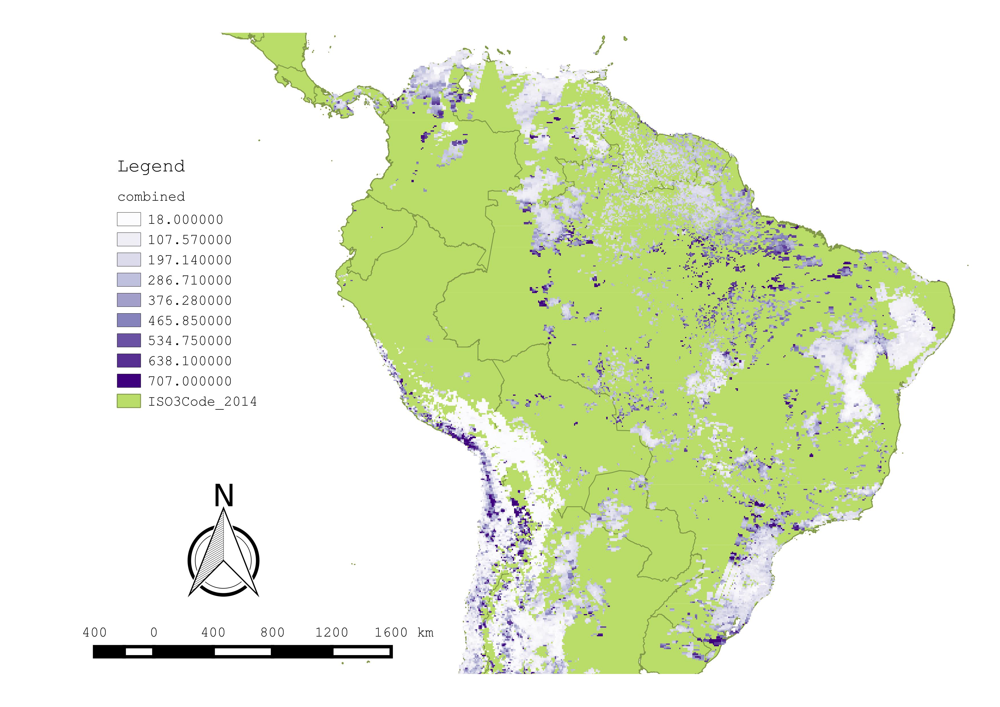

In [32]:
# load the separate MODIS gridded files, combine, resample and save to disk as one file
# did this using on the command line:
# gdal_merge.py -n -9999 -a_nodata -9999 -ul_lr -9127495 1693299 -2537396 -3770302 -init '-9999 0 -9999' -o MODIS_AOT_combined.tif *.

# remember to remove old combined.tif before...

# load and plot the data
from wand.image import Image as WImage
img = WImage(filename='../../Data/MODIS/AOT/image.jpg')
img

# MODIS Daily Grid AOT

Daily mean AOT: 0.161
Daily std  AOT: 0.040


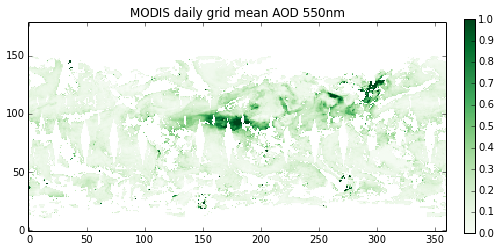

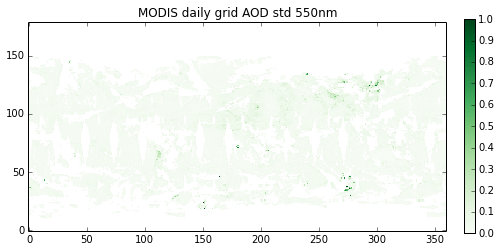

In [5]:
# load the MODIS Daily AOT data
# use the "super combined" Aerosol dataset which uses both Deep Blue and Dark Target
# HDF4_EOS:EOS_GRID:"MOD08_D3.A2007024.006.2014363103257.hdf":mod08:AOD_550_Dark_Target_Deep_Blue_Combined_Mean

import gdal
import glob
import numpy as np
import pdb
import matplotlib.pylab as plt
%matplotlib inline
import os

path = '/home/malapradej/Documents/PhD_UCL/Data/MODIS/Combined/M[OY]D08_D3.A2007025*.hdf'
fns = glob.glob(path)

dss = []
dssd = []

for fn in fns:
    g = gdal.Open(fn)

    if g is None:
        print "Problem opening file %s!" % fn
    else:
        pass#print "File %s opened fine" % fn

    subds = g.GetSubDatasets()

    selected_layers = [  "AOD_550_Dark_Target_Deep_Blue_Combined_Mean", \
                       "AOD_550_Dark_Target_Deep_Blue_Combined_Standard_Deviation"]
    
    data = {}
    
    scale_offset = {}

    file_template = 'HDF4_EOS:EOS_GRID:"%s":mod08:%s'
    
    for i, layer in enumerate ( selected_layers ):
        this_file = file_template % ( fn, layer )
        #print "Opening Layer %d: %s" % (i+1, this_file )
        g = gdal.Open ( this_file )
        if g is None:
            raise IOError
        meta = g.GetMetadata()
        scale_offset[layer] = (float(meta['scale_factor']), float(meta['add_offset']))
        data[layer] = g.ReadAsArray()
        #print "\t>>> Read %s!" % layer

    ds = data["AOD_550_Dark_Target_Deep_Blue_Combined_Mean"]
    ds = np.ma.masked_equal(ds, -9999)
    scale = scale_offset["AOD_550_Dark_Target_Deep_Blue_Combined_Mean"][0]
    offset = scale_offset["AOD_550_Dark_Target_Deep_Blue_Combined_Mean"][1]
    ds = scale * (ds - offset)
    dss.append(ds)
    
    ds = data["AOD_550_Dark_Target_Deep_Blue_Combined_Standard_Deviation"]
    ds = np.ma.masked_equal(ds, -9999)
    scale = scale_offset["AOD_550_Dark_Target_Deep_Blue_Combined_Standard_Deviation"][0]
    offset = scale_offset["AOD_550_Dark_Target_Deep_Blue_Combined_Standard_Deviation"][1]
    ds = scale * (ds - offset)
    dssd.append(ds)

    
dss = np.ma.array(dss)
#dss = np.array(dss)
dss_ave = np.ma.mean(dss, axis=0)

#pdb.set_trace()

dssd = np.ma.array(dssd)
#dssd = np.array(dssd)
dssd_ave = np.ma.mean(dssd, axis=0)

cmap = plt.cm.Greens
plt.figure(figsize=(8,8))
plt.imshow(dss_ave[::-1],interpolation='none',vmin=0.,vmax=1.,cmap=cmap, origin='lower')
plt.title('MODIS daily grid mean AOD 550nm')
plt.colorbar(fraction=0.024, pad=0.04)

cmap = plt.cm.Greens
plt.figure(figsize=(8,8))
plt.imshow(dssd_ave[::-1],interpolation='none',vmin=0.,vmax=1.,cmap=cmap, origin='lower')
plt.title('MODIS daily grid AOD std 550nm')
plt.colorbar(fraction=0.024, pad=0.04)

# tiff file name
fn = 'MODIS_AOT_combined_grid_day.tiff'
fn = os.path.join(os.path.dirname(path), fn)

# create a simple raster from array and save as tiff in equal area projection coords
cols = dss_ave.shape[1]
rows = dss_ave.shape[0]
x_ul, x_dim, rotx, y_ul, roty, y_dim = g.GetGeoTransform()
originX = x_ul
originY = y_ul
pixelWidth = x_dim
pixelHeight = y_dim

NODATA = -9999

driver = gdal.GetDriverByName('GTiff')
outRaster = driver.Create(fn, cols, rows, 2, gdal.GDT_Float32)
outRaster.SetGeoTransform((originX, pixelWidth, 0, originY, 0, pixelHeight))
outband1 = outRaster.GetRasterBand(1)
outband1.WriteArray(dss_ave.filled(NODATA))
outband1.SetNoDataValue(NODATA)
outband2 = outRaster.GetRasterBand(2)
outband2.WriteArray(dssd_ave.filled(NODATA))
outband2.SetNoDataValue(NODATA)
wkt = g.GetProjectionRef()
#outRasterSRS = osr.SpatialReference()
#outRasterSRS.ImportFromEPSG(4326)
outRaster.SetProjection(wkt)
outband1.FlushCache()
outband2.FlushCache()
outRaster = None

print 'Daily mean AOT: %.3f' % np.ma.mean(dss_ave)
print 'Daily std  AOT: %.3f' % np.ma.std(dssd_ave)


# MODIS 8 Day AOT

8 Day mean AOT: 0.160
8 Day std  AOT: 0.083


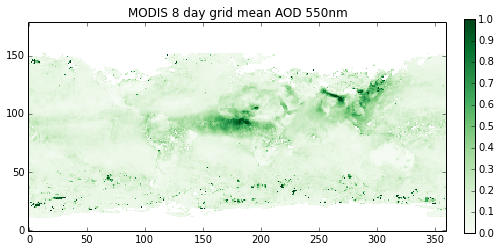

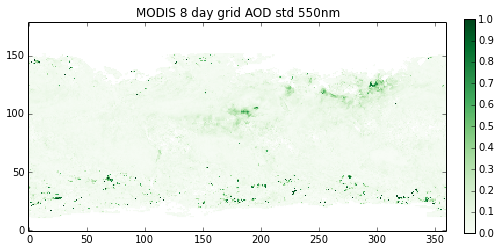

In [4]:
# load the MODIS 8 Day AOT data
# use the "super combined" Aerosol dataset which uses both Deep Blue and Dark Target
# HDF4_EOS:EOS_GRID:"MOD08_E3.A2007025.006.2014363153859.hdf":mod08:AOD_550_Dark_Target_Deep_Blue_Combined_Mean_Mean


import gdal
import glob
import numpy as np
import pdb
import matplotlib.pylab as plt
%matplotlib inline
import os

path = '/home/malapradej/Documents/PhD_UCL/Data/MODIS/Combined/M[OY]D08_E3.A2007025*.hdf'
fns = glob.glob(path)

dss = []
dssd = []

for fn in fns:
    g = gdal.Open(fn)

    if g is None:
        print "Problem opening file %s!" % fn
    else:
        pass#print "File %s opened fine" % fn

    subds = g.GetSubDatasets()

    selected_layers = [  "AOD_550_Dark_Target_Deep_Blue_Combined_Mean_Mean", \
                       "AOD_550_Dark_Target_Deep_Blue_Combined_Mean_Std"]
    
    data = {}
    
    scale_offset = {}

    file_template = 'HDF4_EOS:EOS_GRID:"%s":mod08:%s'
    
    for i, layer in enumerate ( selected_layers ):
        this_file = file_template % ( fn, layer )
        #print "Opening Layer %d: %s" % (i+1, this_file )
        g = gdal.Open ( this_file )
        if g is None:
            raise IOError
        meta = g.GetMetadata()
        scale_offset[layer] = (float(meta['scale_factor']), float(meta['add_offset']))
        data[layer] = g.ReadAsArray()
        #print "\t>>> Read %s!" % layer

    ds = data["AOD_550_Dark_Target_Deep_Blue_Combined_Mean_Mean"]
    ds = np.ma.masked_equal(ds, -9999)
    scale = scale_offset["AOD_550_Dark_Target_Deep_Blue_Combined_Mean_Mean"][0]
    offset = scale_offset["AOD_550_Dark_Target_Deep_Blue_Combined_Mean_Mean"][1]
    ds = scale * (ds - offset)
    dss.append(ds)
    
    ds = data["AOD_550_Dark_Target_Deep_Blue_Combined_Mean_Std"]
    ds = np.ma.masked_equal(ds, -9999)
    scale = scale_offset["AOD_550_Dark_Target_Deep_Blue_Combined_Mean_Std"][0]
    offset = scale_offset["AOD_550_Dark_Target_Deep_Blue_Combined_Mean_Std"][1]
    ds = scale * (ds - offset)
    dssd.append(ds)

    
dss = np.ma.array(dss)
#dss = np.array(dss)
dss_ave = np.ma.mean(dss, axis=0)

#pdb.set_trace()

dssd = np.ma.array(dssd)
#dssd = np.array(dssd)
dssd_ave = np.ma.mean(dssd, axis=0)

cmap = plt.cm.Greens
plt.figure(figsize=(8,8))
plt.imshow(dss_ave[::-1],interpolation='none',vmin=0.,vmax=1.,cmap=cmap, origin='lower')
plt.title('MODIS 8 day grid mean AOD 550nm')
plt.colorbar(fraction=0.024, pad=0.04)

cmap = plt.cm.Greens
plt.figure(figsize=(8,8))
plt.imshow(dssd_ave[::-1],interpolation='none',vmin=0.,vmax=1.,cmap=cmap, origin='lower')
plt.title('MODIS 8 day grid AOD std 550nm')
plt.colorbar(fraction=0.024, pad=0.04)

# tiff file name
fn = 'MODIS_AOT_combined_grid_8_day.tiff'
fn = os.path.join(os.path.dirname(path), fn)

# create a simple raster from array and save as tiff in equal area projection coords
cols = dss_ave.shape[1]
rows = dss_ave.shape[0]
x_ul, x_dim, rotx, y_ul, roty, y_dim = g.GetGeoTransform()
originX = x_ul
originY = y_ul
pixelWidth = x_dim
pixelHeight = y_dim


NODATA = -9999

driver = gdal.GetDriverByName('GTiff')
outRaster = driver.Create(fn, cols, rows, 2, gdal.GDT_Float32)
outRaster.SetGeoTransform((originX, pixelWidth, 0, originY, 0, pixelHeight))
outband1 = outRaster.GetRasterBand(1)
outband1.WriteArray(dss_ave.filled(NODATA))
outband1.SetNoDataValue(NODATA)
outband2 = outRaster.GetRasterBand(2)
outband2.WriteArray(dssd_ave.filled(NODATA))
outband2.SetNoDataValue(NODATA)
wkt = g.GetProjectionRef()
#outRasterSRS = osr.SpatialReference()
#outRasterSRS.ImportFromEPSG(4326)
outRaster.SetProjection(wkt)
outband1.FlushCache()
outband2.FlushCache()
outRaster = None

print '8 Day mean AOT: %.3f' % np.ma.mean(dss_ave)
print '8 Day std  AOT: %.3f' % np.ma.std(dssd_ave)


# MODIS Monthy AOT

Monthly mean AOT: 0.166
Monthly std  AOT: 0.108


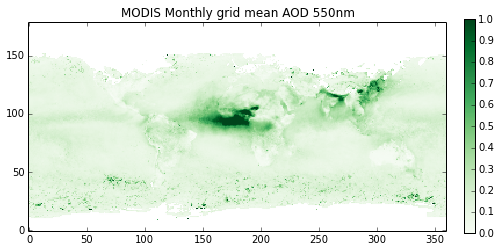

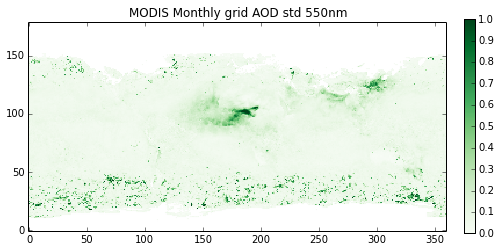

In [3]:
# load the MODIS Monthly AOT data
# use the "super combined" Aerosol dataset which uses both Deep Blue and Dark Target


import gdal
import glob
import numpy as np
import pdb
import matplotlib.pylab as plt
%matplotlib inline
import os

path = '/home/malapradej/Documents/PhD_UCL/Data/MODIS/Combined/M[OY]D08_M3.A2007001*.hdf'
fns = glob.glob(path)

dss = []
dssd = []

for fn in fns:
    g = gdal.Open(fn)

    if g is None:
        print "Problem opening file %s!" % fn
    else:
        pass#print "File %s opened fine" % fn

    subds = g.GetSubDatasets()

    selected_layers = [  "AOD_550_Dark_Target_Deep_Blue_Combined_Mean_Mean", \
                       "AOD_550_Dark_Target_Deep_Blue_Combined_Mean_Std"]
    
    data = {}
    
    scale_offset = {}

    file_template = 'HDF4_EOS:EOS_GRID:"%s":mod08:%s'
    
    for i, layer in enumerate ( selected_layers ):
        this_file = file_template % ( fn, layer )
        #print "Opening Layer %d: %s" % (i+1, this_file )
        g = gdal.Open ( this_file )
        if g is None:
            raise IOError
        meta = g.GetMetadata()
        scale_offset[layer] = (float(meta['scale_factor']), float(meta['add_offset']))
        data[layer] = g.ReadAsArray()
        #print "\t>>> Read %s!" % layer

    ds = data["AOD_550_Dark_Target_Deep_Blue_Combined_Mean_Mean"]
    ds = np.ma.masked_equal(ds, -9999)
    scale = scale_offset["AOD_550_Dark_Target_Deep_Blue_Combined_Mean_Mean"][0]
    offset = scale_offset["AOD_550_Dark_Target_Deep_Blue_Combined_Mean_Mean"][1]
    ds = scale * (ds - offset)
    dss.append(ds)
    
    ds = data["AOD_550_Dark_Target_Deep_Blue_Combined_Mean_Std"]
    ds = np.ma.masked_equal(ds, -9999)
    scale = scale_offset["AOD_550_Dark_Target_Deep_Blue_Combined_Mean_Std"][0]
    offset = scale_offset["AOD_550_Dark_Target_Deep_Blue_Combined_Mean_Std"][1]
    ds = scale * (ds - offset)
    dssd.append(ds)

    
dss = np.ma.array(dss)
#dss = np.array(dss)
dss_ave = np.ma.mean(dss, axis=0)

#pdb.set_trace()

dssd = np.ma.array(dssd)
#dssd = np.array(dssd)
dssd_ave = np.ma.mean(dssd, axis=0)

cmap = plt.cm.Greens
plt.figure(figsize=(8,8))
plt.imshow(dss_ave[::-1],interpolation='none',vmin=0.,vmax=1.,cmap=cmap, origin='lower')
plt.title('MODIS Monthly grid mean AOD 550nm')
plt.colorbar(fraction=0.024, pad=0.04)

cmap = plt.cm.Greens
plt.figure(figsize=(8,8))
plt.imshow(dssd_ave[::-1],interpolation='none',vmin=0.,vmax=1.,cmap=cmap, origin='lower')
plt.title('MODIS Monthly grid AOD std 550nm')
plt.colorbar(fraction=0.024, pad=0.04)

# tiff file name
fn = 'MODIS_AOT_combined_grid_Monthly.tiff'
fn = os.path.join(os.path.dirname(path), fn)

# create a simple raster from array and save as tiff in equal area projection coords
cols = dss_ave.shape[1]
rows = dss_ave.shape[0]
x_ul, x_dim, rotx, y_ul, roty, y_dim = g.GetGeoTransform()
originX = x_ul
originY = y_ul
pixelWidth = x_dim
pixelHeight = y_dim

NODATA = -9999

driver = gdal.GetDriverByName('GTiff')
outRaster = driver.Create(fn, cols, rows, 2, gdal.GDT_Float32)
outRaster.SetGeoTransform((originX, pixelWidth, 0, originY, 0, pixelHeight))
outband1 = outRaster.GetRasterBand(1)
outband1.WriteArray(dss_ave.filled(NODATA))
outband1.SetNoDataValue(NODATA)
outband2 = outRaster.GetRasterBand(2)
outband2.WriteArray(dssd_ave.filled(NODATA))
outband2.SetNoDataValue(NODATA)
wkt = g.GetProjectionRef()
#outRasterSRS = osr.SpatialReference()
#outRasterSRS.ImportFromEPSG(4326)
outRaster.SetProjection(wkt)
outband1.FlushCache()
outband2.FlushCache()
outRaster = None

print 'Monthly mean AOT: %.3f' % np.ma.mean(dss_ave)
print 'Monthly std  AOT: %.3f' % np.ma.std(dssd_ave)


# SeaWifs Monthly AOT

5 year mean AOT: 0.139
5 year std  AOT: 0.061


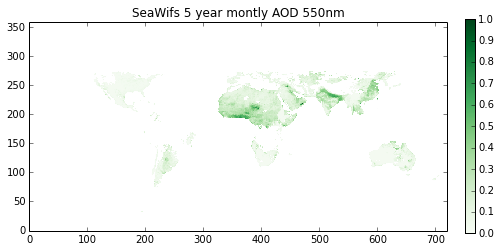

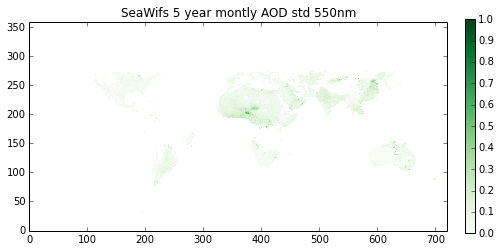

In [13]:
# load the SeaWifs monthly data and average the data
# not enough data in a single year to cover the tropics, so average over 5 years to increase the chances

import numpy as np
import gdal
import glob
import osr
import os
import matplotlib.pylab as plt
%matplotlib inline

path = '/home/malapradej/Documents/PhD_UCL/Data/SeaWIFS/Aerosols/DeepBlue-SeaWiFS-0.5_L3M_200?12*.h5'
fns = glob.glob(path)

dss = []
dssd = []

for fn in fns:
    g = gdal.Open(fn)

    if g is None:
        print "Problem opening file %s!" % fn
    else:
        pass#print "File %s opened fine" % fn

    selected_layers = [  "//aerosol_optical_thickness_550_land", "//aerosol_optical_thickness_550_stddev_land"]
    data = {}

    file_template = 'HDF5:"%s":%s'

    for i, layer in enumerate ( selected_layers ):
        this_file = file_template % ( fn, layer )
        #print "Opening Layer %d: %s" % (i+1, this_file )
        g = gdal.Open ( this_file )

        if g is None:
            raise IOError
        data[layer] = g.ReadAsArray() 
        #print "\t>>> Read %s!" % layer

    ds = data["//aerosol_optical_thickness_550_land"]
    ds = np.where(ds==-999, np.nan, ds)
    dss.append(ds)
    
    ds = data["//aerosol_optical_thickness_550_stddev_land"]
    ds = np.where(ds==-999, np.nan, ds)
    dssd.append(ds)

dss = np.array(dss)
dss_ave = np.nanmean(dss, axis=0)

dssd = np.array(dssd)
dssd_ave = np.nanmean(dssd, axis=0)

cmap = plt.cm.Greens
plt.figure(figsize=(8,8))
plt.imshow(dss_ave,interpolation='none',vmin=0.,vmax=1.,cmap=cmap, origin='lower')
plt.title('SeaWifs 5 year montly AOD 550nm')
plt.colorbar(fraction=0.024, pad=0.04)

cmap = plt.cm.Greens
plt.figure(figsize=(8,8))
plt.imshow(dssd_ave,interpolation='none',vmin=0.,vmax=1.,cmap=cmap, origin='lower')
plt.title('SeaWifs 5 year montly AOD std 550nm')
plt.colorbar(fraction=0.024, pad=0.04)


# tiff file name
fn = 'SeaWifs_AOT_combined_5_year_Dec.tiff'
fn = os.path.join(os.path.dirname(path), fn)

# create a simple raster from array and save as tiff in wgs84 coords
cols = dss_ave.shape[1]
rows = dss_ave.shape[0]
originX = -180.
originY = 90.
pixelWidth = 0.5
pixelHeight = -0.5

# reverse array
dss_ave = dss_ave[::-1]
dssd_ave = dssd_ave[::-1]

driver = gdal.GetDriverByName('GTiff')
outRaster = driver.Create(fn, cols, rows, 2, gdal.GDT_Float32)
outRaster.SetGeoTransform((originX, pixelWidth, 0, originY, 0, pixelHeight))
outband1 = outRaster.GetRasterBand(1)
outband1.WriteArray(dss_ave)
outband2 = outRaster.GetRasterBand(2)
outband2.WriteArray(dssd_ave)
outRasterSRS = osr.SpatialReference()
outRasterSRS.ImportFromEPSG(4326)
outRaster.SetProjection(outRasterSRS.ExportToWkt())
outband1.FlushCache()
outband2.FlushCache()
outRaster = None


print '5 year mean AOT: %.3f' % np.nanmean(dss_ave)
print '5 year std  AOT: %.3f' % np.nanstd(dssd_ave)



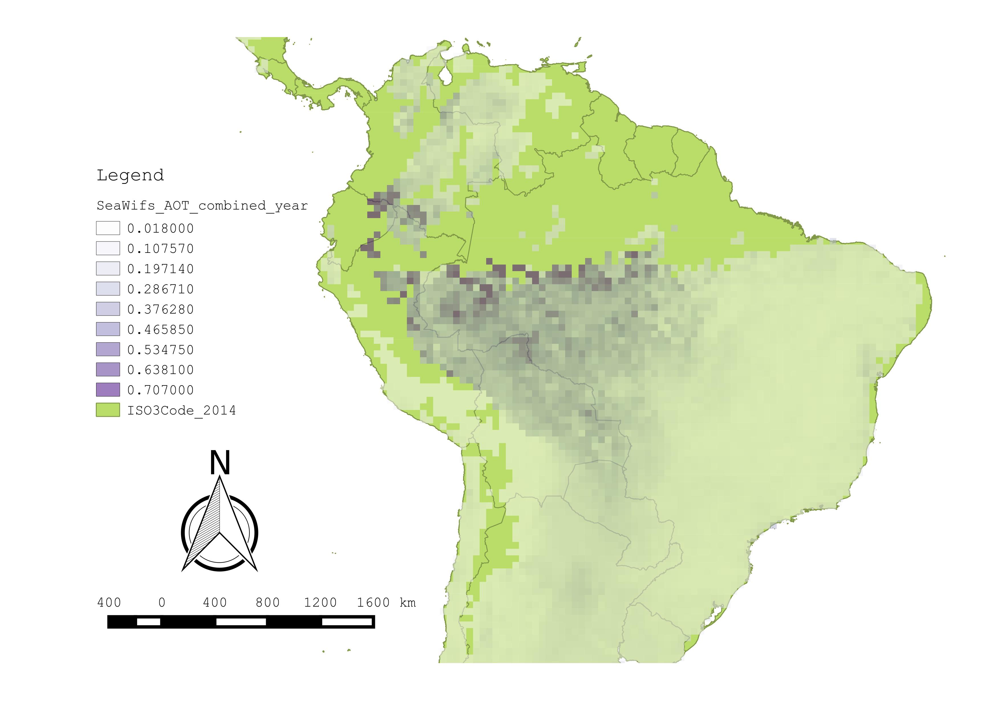

In [11]:
# load and plot the data
from wand.image import Image as WImage
img = WImage(filename='../../Data/SeaWIFS/Aerosols/image_5_year.jpg')
img

# SeaWifs Daily AOT

Daily mean AOT: 0.180
Daily std  AOT: 0.032


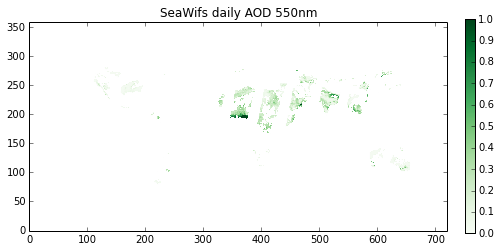

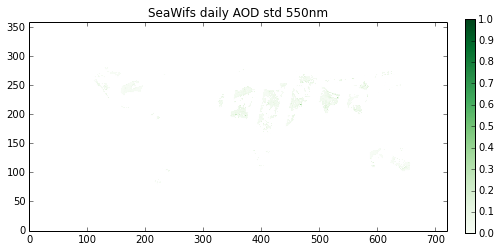

In [16]:
# load the SeaWifs daily data
import gdal
import glob

path = '/home/malapradej/Documents/PhD_UCL/Data/SeaWIFS/Aerosols/DeepBlue-SeaWiFS-0.5_L3_20070125*.h5'
fns = glob.glob(path)

dss = []
dssd = []

for fn in fns:
    g = gdal.Open(fn)

    if g is None:
        print "Problem opening file %s!" % fn
    else:
        pass#print "File %s opened fine" % fn

    subds = g.GetSubDatasets()

    selected_layers = [  "//aerosol_optical_thickness_550_land", "//aerosol_optical_thickness_550_stddev_land"]
    data = {}

    file_template = 'HDF5:"%s":%s'

    for i, layer in enumerate ( selected_layers ):
        this_file = file_template % ( fn, layer )
        #print "Opening Layer %d: %s" % (i+1, this_file )
        g = gdal.Open ( this_file )

        if g is None:
            raise IOError
        data[layer] = g.ReadAsArray() 
        #print "\t>>> Read %s!" % layer

    ds = data["//aerosol_optical_thickness_550_land"]
    ds = np.where(ds==-999, np.nan, ds)
    dss.append(ds)
    
    ds = data["//aerosol_optical_thickness_550_stddev_land"]
    ds = np.where(ds==-999, np.nan, ds)
    dssd.append(ds)


dss = np.array(dss)
dss_ave = np.nanmean(dss, axis=0)

dssd = np.array(dssd)
dssd_ave = np.nanmean(dssd, axis=0)

cmap = plt.cm.Greens
plt.figure(figsize=(8,8))
plt.imshow(dss_ave,interpolation='none',vmin=0.,vmax=1.,cmap=cmap, origin='lower')
plt.title('SeaWifs daily AOD 550nm')
plt.colorbar(fraction=0.024, pad=0.04)

cmap = plt.cm.Greens
plt.figure(figsize=(8,8))
plt.imshow(dssd_ave,interpolation='none',vmin=0.,vmax=1.,cmap=cmap, origin='lower')
plt.title('SeaWifs daily AOD std 550nm')
plt.colorbar(fraction=0.024, pad=0.04)


# tiff file name
fn = 'SeaWifs_AOT_combined_day.tiff'
fn = os.path.join(os.path.dirname(path), fn)

# create a simple raster from array and save as tiff in wgs84 coords
cols = dss_ave.shape[1]
rows = dss_ave.shape[0]
originX = -180.
originY = 90.
pixelWidth = 0.5
pixelHeight = -0.5

# reverse array
dss_ave = dss_ave[::-1]
dssd_ave = dssd_ave[::-1]

driver = gdal.GetDriverByName('GTiff')
outRaster = driver.Create(fn, cols, rows, 2, gdal.GDT_Float32)
outRaster.SetGeoTransform((originX, pixelWidth, 0, originY, 0, pixelHeight))
outband1 = outRaster.GetRasterBand(1)
outband1.WriteArray(dss_ave)
outband2 = outRaster.GetRasterBand(2)
outband2.WriteArray(dssd_ave)
outRasterSRS = osr.SpatialReference()
outRasterSRS.ImportFromEPSG(4326)
outRaster.SetProjection(outRasterSRS.ExportToWkt())
outband1.FlushCache()
outband2.FlushCache()
outRaster = None

print 'Daily mean AOT: %.3f' % np.nanmean(dss_ave)
print 'Daily std  AOT: %.3f' % np.nanstd(dssd_ave)


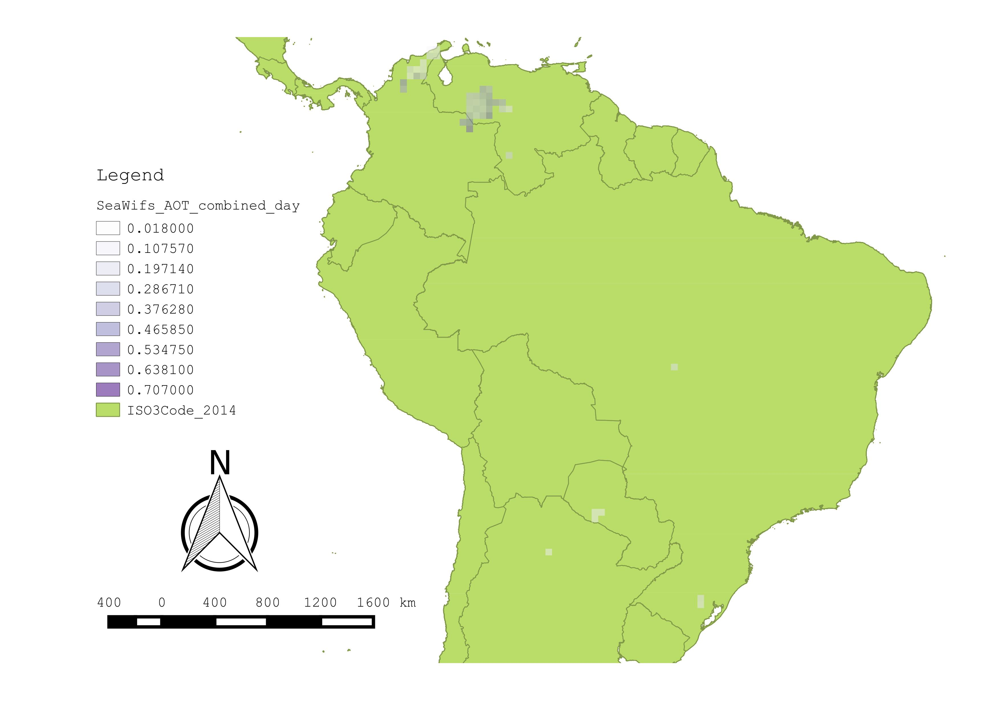

In [12]:
# load and plot the data
from wand.image import Image as WImage
img = WImage(filename='../../Data/SeaWIFS/Aerosols/image_day.jpg')
img

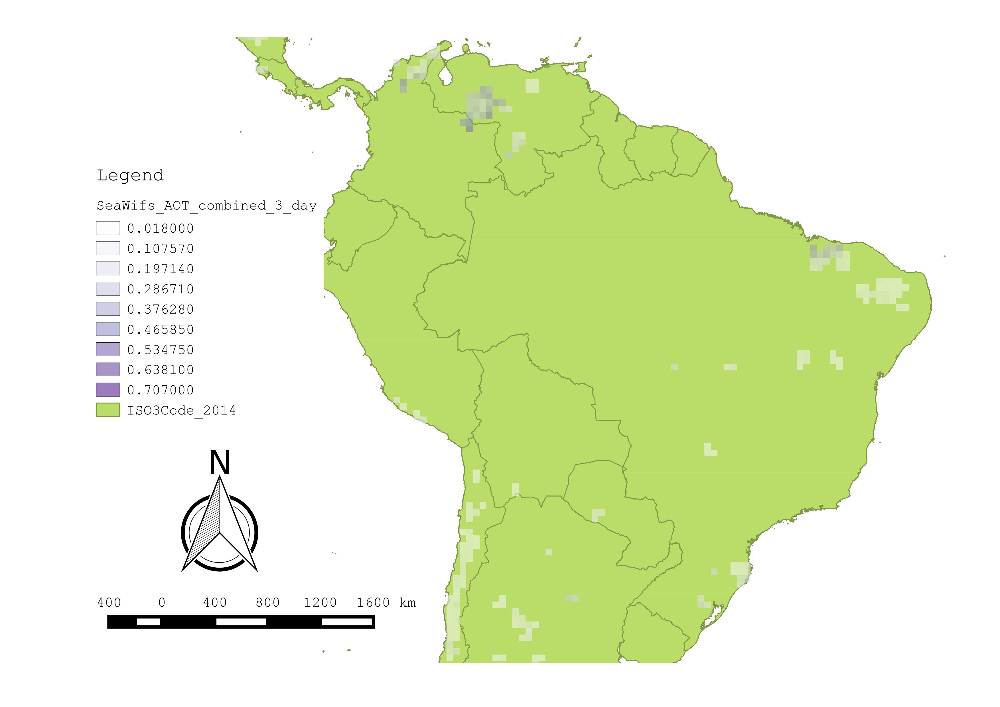

In [17]:
# load and plot the data
from wand.image import Image as WImage
img = WImage(filename='../../Data/SeaWIFS/Aerosols/image_3_day.jpg')
img

# MODIS Daily WVC

file saved: /home/malapradej/Documents/PhD_UCL/Data/MODIS/WVC/MOD07_L2.A2007025.1235.006.2014361205248.tiff
file saved: /home/malapradej/Documents/PhD_UCL/Data/MODIS/WVC/MOD07_L2.A2007025.1240.006.2014361205623.tiff
file saved: /home/malapradej/Documents/PhD_UCL/Data/MODIS/WVC/MOD07_L2.A2007025.1245.006.2014361205142.tiff
file saved: /home/malapradej/Documents/PhD_UCL/Data/MODIS/WVC/MOD07_L2.A2007025.1250.006.2014361205419.tiff
file saved: /home/malapradej/Documents/PhD_UCL/Data/MODIS/WVC/MOD07_L2.A2007025.1415.006.2014361205327.tiff
file saved: /home/malapradej/Documents/PhD_UCL/Data/MODIS/WVC/MOD07_L2.A2007025.1420.006.2014361205239.tiff
file saved: /home/malapradej/Documents/PhD_UCL/Data/MODIS/WVC/MOD07_L2.A2007025.1425.006.2014361205215.tiff
file saved: /home/malapradej/Documents/PhD_UCL/Data/MODIS/WVC/MOD07_L2.A2007025.1430.006.2014361205312.tiff
file saved: /home/malapradej/Documents/PhD_UCL/Data/MODIS/WVC/MOD07_L2.A2007025.1555.006.2014361205328.tiff
file saved: /home/malapradej

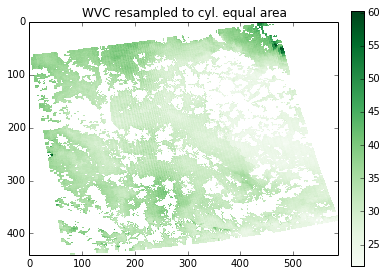

In [10]:
# load the MODIS WVC daily swath data and saves it a gridded tiff
import gdal
import os
import glob
import pdb
from pyresample import image, geometry, utils, kd_tree
import osr
    
path = '/home/malapradej/Documents/PhD_UCL/Data/MODIS/WVC/M[OY]D07_L2.A2007025.*.hdf'
fns = sorted(glob.glob(path))

for i, fn in enumerate(fns):
    
#     if i != 10:
#         continue
    
    g = gdal.Open(fn)

    if g is None:
        print "Problem opening file %s!" % fn
    else:
        pass #print "File %s opened fine" % fn

    subds = g.GetSubDatasets()

    selected_layers = ["Water_Vapor", "Quality_Assurance_Infrared", \
                       "Latitude", "Longitude"]
    data = {}

    file_template = 'HDF4_EOS:EOS_SWATH:"%s":mod07:%s'
    
    scale_offset = {}
    
    for i, layer in enumerate ( selected_layers ):
        this_file = file_template % ( fn, layer )
        #print "Opening Layer %d: %s" % (i+1, this_file )
        g = gdal.Open ( this_file )
        if g is None:
            raise IOError
        meta = g.GetMetadata()
        scale_offset[layer] = (float(meta['scale_factor']), float(meta['add_offset']))
        data[layer] = g.ReadAsArray()
        #print "\t>>> Read %s!" % layer

    import matplotlib.pylab as plt
    import numpy as np
    %matplotlib inline
    
    lats = data['Latitude']
    lats = np.ma.masked_equal(lats, -999)
    scale, offset = scale_offset['Latitude']
    lats = scale*(lats - offset)
    
    lons = data['Longitude']
    lons = np.ma.masked_equal(lons, -999)
    scale, offset = scale_offset['Latitude']
    lons = scale*(lons - offset)

    ds = data["Water_Vapor"] 
    ds = np.ma.masked_equal(ds,-9999) #/ 1000.
    scale, offset = scale_offset["Water_Vapor"]
    ds = scale*(ds - offset)
    ds = ds*10 # from cm/m2 to kg/m2

    qcir = data["Quality_Assurance_Infrared"][:,:,0]
    qcir = np.ma.masked_equal(qcir, 255) #/ 1000.
    
#     cmap = plt.cm.Greens
#     plt.figure(figsize=(6,6))
#     plt.imshow(ds,interpolation='none',cmap=cmap)
#     plt.title('MODIS WVC IR Swath')
#     plt.colorbar()

    # set up the swath
    
    # set up the area/grid
    meta = g.GetMetadata()

    #lam_ll = lons.min()
    #phi_ll = lats.min()
    #lam_ur = lons.max()
    #phi_ur = lats.max()

    lam_ll = float(meta['WESTBOUNDINGCOORDINATE'])
    phi_ll = float(meta['SOUTHBOUNDINGCOORDINATE'])
    lam_ur = float(meta['EASTBOUNDINGCOORDINATE'])
    phi_ur = float(meta['NORTHBOUNDINGCOORDINATE'])

    semi_major = 6378137.0
    semi_minor = 6356752.3142
    std_lon = 0.
    std_lat = 0.
    pixdim = 5000.0

    x_ll = (lam_ll*np.pi/180. - std_lon*np.pi/180.) * semi_major
    x_ur = (lam_ur*np.pi/180. - std_lon*np.pi/180.) * semi_major
    y_ll = np.sin(phi_ll*np.pi/180.) * semi_minor
    y_ur = np.sin(phi_ur*np.pi/180.) * semi_minor

    area_extent = (x_ll, y_ll, x_ur, y_ur)
    area_id = meta['LOCALGRANULEID']
    area_name = meta['LOCALGRANULEID']
    proj_id = meta['LOCALGRANULEID']
    proj4_args = '+proj=cea +lon_0=0 +lat_ts=0 +x_0=0 +y_0=0 +ellps=WGS84 +units=m'# m +no_defs'
    proj_dict = {'a': str(semi_major), 'units': 'm', 'lon_0': '0', 'proj': 'cea', 'lat_0': '0'}

    # convert to projected coords in meters see http://mathworld.wolfram.com/CylindricalEqual-AreaProjection.html
    # also my book: Snyder 1997
    dlam = np.abs(lam_ll - lam_ur)
    dy = np.abs(np.sin(phi_ll*np.pi/180.) - np.sin(phi_ur*np.pi/180.))

    x_size = int(semi_major*2.*np.pi / 360. / pixdim * dlam) #135
    y_size = int(dy * semi_minor / pixdim) #203

    area_def = utils.get_area_def(area_id, area_name, proj_id, proj4_args, x_size, y_size, area_extent)

    swath_def = geometry.SwathDefinition(lons=lons, lats=lats)

    #swath_con = image.ImageContainerNearest(ds, swath_def, radius_of_influence=20000)

    ds_proj = kd_tree.resample_nearest(swath_def, ds, area_def, radius_of_influence=20000, epsilon=0.5, fill_value=None)
    qcir_proj = kd_tree.resample_nearest(swath_def, qcir, area_def, radius_of_influence=20000, epsilon=0.5, fill_value=None)
    
    #geometry.AreaDefinition
    cmap = plt.cm.Greens
    plt.figure(figsize=(6,6))
    plt.imshow(ds_proj,interpolation='none',cmap=cmap)
    plt.title('WVC resampled to cyl. equal area')
    plt.colorbar(fraction=0.038, pad=0.04)

#     cmap = plt.cm.Blues
#     plt.figure(figsize=(6,6))
#     plt.imshow(qcir_proj,interpolation='none',cmap=cmap)
#     plt.title('WVC QC IR resampled')
#     plt.colorbar(fraction=0.038, pad=0.04)
    
    # save array to raster file
    dst_filename = os.path.basename(fn)
    dst_filename = os.path.splitext(dst_filename)[0]
    dst_filename = '%s.tiff' % dst_filename
    dst_filename = os.path.join(os.path.dirname(path), dst_filename)

    # You need to get those values like you did.
    x_pixels = x_size  # number of pixels in x
    y_pixels = y_size  # number of pixels in y
    PIXEL_SIZE = pixdim  # size of the pixel...        
    x_min = x_ll  
    y_max = y_ur  # x_min & y_max are like the "top left" corner.
    
    # convert proj4 to wkt
    srs = osr.SpatialReference()
    srs.ImportFromProj4(proj4_args)
    wkt_projection = srs.ExportToWkt()
    
    driver = gdal.GetDriverByName('GTiff')

    dataset = driver.Create(dst_filename, x_pixels, y_pixels, 2, gdal.GDT_Float32)
    
    dataset.SetProjection(wkt_projection)
    dataset.SetGeoTransform((x_min, PIXEL_SIZE, 0, y_max, 0, -PIXEL_SIZE))
    
    NODATA1 = -9999
    
    band1 = dataset.GetRasterBand(1)
    band1.SetNoDataValue(NODATA1)
    band1.WriteArray(ds_proj.filled(NODATA1))# .SetNoDataValue(NODATA)
    
    #NODATA2 = 255
    
    band2 = dataset.GetRasterBand(2)
    #band2.SetNoDataValue(NODATA2)
    band2.WriteArray(qcir_proj) #.filled(NODATA2))
    
    dataset.FlushCache()  # Write to disk.
    dataset = None
    print 'file saved: %s' % dst_filename

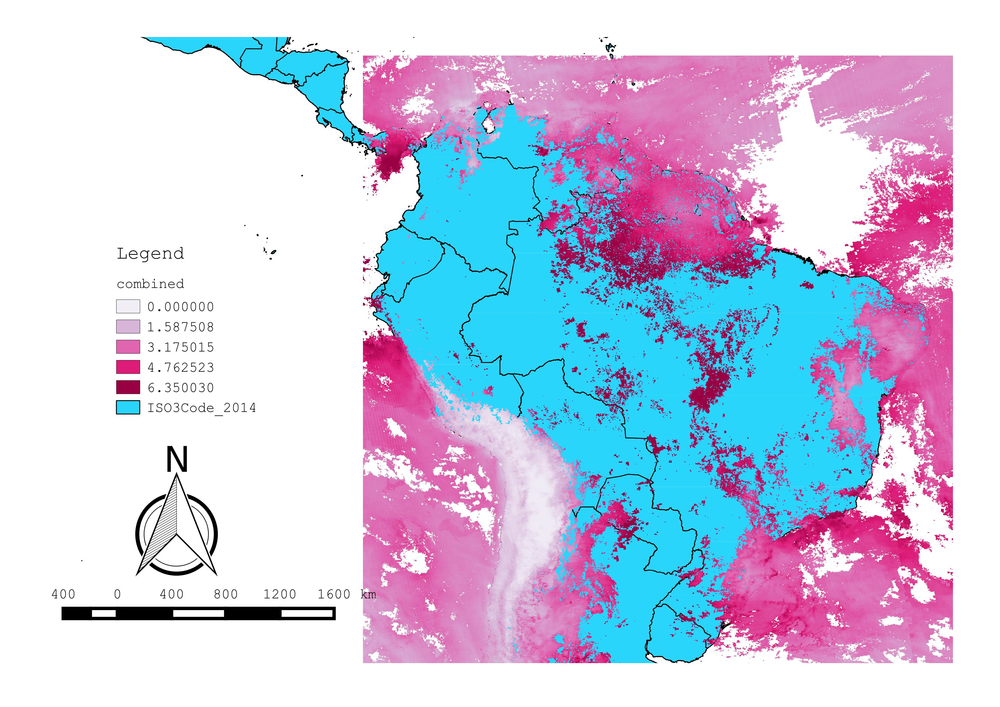

In [244]:
# load and plot the data
from wand.image import Image as WImage
img = WImage(filename='../../Data/MODIS/WVC/image.jpg')
img

# MODIS Daily Grid WVC

Daily mean WVC: 17.398
Daily std  WVC: 2.392


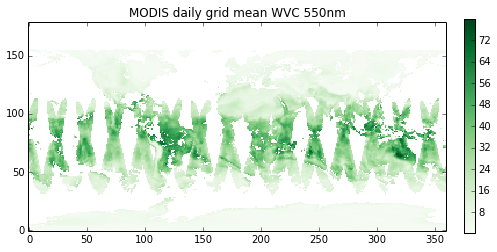

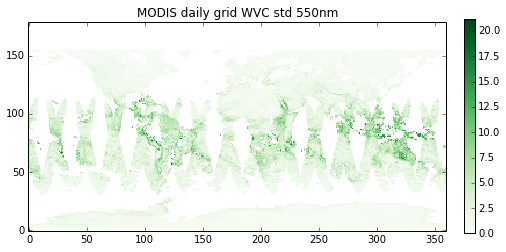

In [11]:
# load the MODIS Daily WVC data
# use the "super combined" Aerosol dataset which uses both Deep Blue and Dark Target
# HDF4_EOS:EOS_GRID:"MOD08_D3.A2007024.006.2014363103257.hdf":mod08:AOD_550_Dark_Target_Deep_Blue_Combined_Mean

import gdal
import glob
import numpy as np
import pdb
import matplotlib.pylab as plt
%matplotlib inline
import os

path = '/home/malapradej/Documents/PhD_UCL/Data/MODIS/Combined/M[OY]D08_D3.A2007025*.hdf'
fns = glob.glob(path)

dss = []
dssd = []

for fn in fns:
    g = gdal.Open(fn)

    if g is None:
        print "Problem opening file %s!" % fn
    else:
        pass#print "File %s opened fine" % fn

    subds = g.GetSubDatasets()

    selected_layers = [  "Water_Vapor_Near_Infrared_Clear_Mean", \
                       "Water_Vapor_Near_Infrared_Clear_Standard_Deviation"]
    
    data = {}
    
    scale_offset = {}

    file_template = 'HDF4_EOS:EOS_GRID:"%s":mod08:%s'
    
    for i, layer in enumerate ( selected_layers ):
        this_file = file_template % ( fn, layer )
        #print "Opening Layer %d: %s" % (i+1, this_file )
        g = gdal.Open ( this_file )
        if g is None:
            raise IOError
        meta = g.GetMetadata()
        scale_offset[layer] = (float(meta['scale_factor']), float(meta['add_offset']))
        data[layer] = g.ReadAsArray()
        #print "\t>>> Read %s!" % layer

    ds = data["Water_Vapor_Near_Infrared_Clear_Mean"]
    ds = np.ma.masked_equal(ds, -9999)
    scale = scale_offset["Water_Vapor_Near_Infrared_Clear_Mean"][0]
    offset = scale_offset["Water_Vapor_Near_Infrared_Clear_Mean"][1]
    ds = scale * (ds - offset)
    ds = ds * 10. # convert from cm to kg/m2
    dss.append(ds)
    
    ds = data["Water_Vapor_Near_Infrared_Clear_Standard_Deviation"]
    ds = np.ma.masked_equal(ds, -9999)
    scale = scale_offset["Water_Vapor_Near_Infrared_Clear_Standard_Deviation"][0]
    offset = scale_offset["Water_Vapor_Near_Infrared_Clear_Standard_Deviation"][1]
    ds = scale * (ds - offset)
    ds = ds * 10. # convert from cm to kg/m2
    dssd.append(ds)

    
dss = np.ma.array(dss)
#dss = np.array(dss)
dss_ave = np.ma.mean(dss, axis=0)

#pdb.set_trace()

dssd = np.ma.array(dssd)
#dssd = np.array(dssd)
dssd_ave = np.ma.mean(dssd, axis=0)

cmap = plt.cm.Greens
plt.figure(figsize=(8,8))
plt.imshow(dss_ave[::-1],interpolation='none',cmap=cmap, origin='lower')
plt.title('MODIS daily grid mean WVC 550nm')
plt.colorbar(fraction=0.024, pad=0.04)

cmap = plt.cm.Greens
plt.figure(figsize=(8,8))
plt.imshow(dssd_ave[::-1],interpolation='none',cmap=cmap, origin='lower')
plt.title('MODIS daily grid WVC std 550nm')
plt.colorbar(fraction=0.024, pad=0.04)

# tiff file name
fn = 'MODIS_WVC_combined_grid_day.tiff'
fn = os.path.join(os.path.dirname(path), fn)

# create a simple raster from array and save as tiff in equal area projection coords
cols = dss_ave.shape[1]
rows = dss_ave.shape[0]
x_ul, x_dim, rotx, y_ul, roty, y_dim = g.GetGeoTransform()
originX = x_ul
originY = y_ul
pixelWidth = x_dim
pixelHeight = y_dim

NODATA = -9999

driver = gdal.GetDriverByName('GTiff')
outRaster = driver.Create(fn, cols, rows, 2, gdal.GDT_Float32)
outRaster.SetGeoTransform((originX, pixelWidth, 0, originY, 0, pixelHeight))
outband1 = outRaster.GetRasterBand(1)
outband1.WriteArray(dss_ave.filled(NODATA))
outband1.SetNoDataValue(NODATA)
outband2 = outRaster.GetRasterBand(2)
outband2.WriteArray(dssd_ave.filled(NODATA))
outband2.SetNoDataValue(NODATA)
wkt = g.GetProjectionRef()
#outRasterSRS = osr.SpatialReference()
#outRasterSRS.ImportFromEPSG(4326)
outRaster.SetProjection(wkt)
outband1.FlushCache()
outband2.FlushCache()
outRaster = None

print 'Daily mean WVC: %.3f' % np.ma.mean(dss_ave)
print 'Daily std  WVC: %.3f' % np.ma.std(dssd_ave)


# MODIS 8 Day WVC

8 Day mean WVC: 20.151
8 Day std  WVC: 2.682


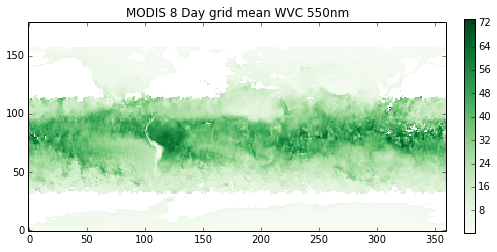

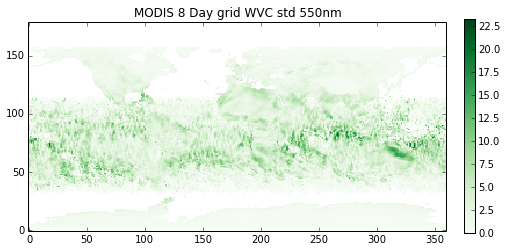

In [12]:
# load the MODIS 8 Day WVC data
# use the "super combined" Aerosol dataset which uses both Deep Blue and Dark Target

import gdal
import glob
import numpy as np
import pdb
import matplotlib.pylab as plt
%matplotlib inline
import os

path = '/home/malapradej/Documents/PhD_UCL/Data/MODIS/Combined/M[OY]D08_E3.A2007025*.hdf'
fns = glob.glob(path)

dss = []
dssd = []

for fn in fns:
    g = gdal.Open(fn)

    if g is None:
        print "Problem opening file %s!" % fn
    else:
        pass#print "File %s opened fine" % fn

    subds = g.GetSubDatasets()

    selected_layers = [  "Water_Vapor_Near_Infrared_Clear_Mean_Mean", \
                       "Water_Vapor_Near_Infrared_Clear_Mean_Std"]
    
    data = {}
    
    scale_offset = {}

    file_template = 'HDF4_EOS:EOS_GRID:"%s":mod08:%s'
    
    for i, layer in enumerate ( selected_layers ):
        this_file = file_template % ( fn, layer )
        #print "Opening Layer %d: %s" % (i+1, this_file )
        g = gdal.Open ( this_file )
        if g is None:
            raise IOError
        meta = g.GetMetadata()
        scale_offset[layer] = (float(meta['scale_factor']), float(meta['add_offset']))
        data[layer] = g.ReadAsArray()
        #print "\t>>> Read %s!" % layer

    ds = data["Water_Vapor_Near_Infrared_Clear_Mean_Mean"]
    ds = np.ma.masked_equal(ds, -9999)
    scale = scale_offset["Water_Vapor_Near_Infrared_Clear_Mean_Mean"][0]
    offset = scale_offset["Water_Vapor_Near_Infrared_Clear_Mean_Mean"][1]
    ds = scale * (ds - offset)
    ds = ds * 10. # convert from cm to kg/m2
    dss.append(ds)
    
    ds = data["Water_Vapor_Near_Infrared_Clear_Mean_Std"]
    ds = np.ma.masked_equal(ds, -9999)
    scale = scale_offset["Water_Vapor_Near_Infrared_Clear_Mean_Std"][0]
    offset = scale_offset["Water_Vapor_Near_Infrared_Clear_Mean_Std"][1]
    ds = scale * (ds - offset)
    ds = ds * 10. # convert from cm to kg/m2
    dssd.append(ds)

    
dss = np.ma.array(dss)
#dss = np.array(dss)
dss_ave = np.ma.mean(dss, axis=0)

#pdb.set_trace()

dssd = np.ma.array(dssd)
#dssd = np.array(dssd)
dssd_ave = np.ma.mean(dssd, axis=0)

cmap = plt.cm.Greens
plt.figure(figsize=(8,8))
plt.imshow(dss_ave[::-1],interpolation='none',cmap=cmap, origin='lower')
plt.title('MODIS 8 Day grid mean WVC 550nm')
plt.colorbar(fraction=0.024, pad=0.04)

cmap = plt.cm.Greens
plt.figure(figsize=(8,8))
plt.imshow(dssd_ave[::-1],interpolation='none',cmap=cmap, origin='lower')
plt.title('MODIS 8 Day grid WVC std 550nm')
plt.colorbar(fraction=0.024, pad=0.04)

# tiff file name
fn = 'MODIS_WVC_combined_grid_8_day.tiff'
fn = os.path.join(os.path.dirname(path), fn)

# create a simple raster from array and save as tiff in equal area projection coords
cols = dss_ave.shape[1]
rows = dss_ave.shape[0]
x_ul, x_dim, rotx, y_ul, roty, y_dim = g.GetGeoTransform()
originX = x_ul
originY = y_ul
pixelWidth = x_dim
pixelHeight = y_dim

NODATA = -9999

driver = gdal.GetDriverByName('GTiff')
outRaster = driver.Create(fn, cols, rows, 2, gdal.GDT_Float32)
outRaster.SetGeoTransform((originX, pixelWidth, 0, originY, 0, pixelHeight))
outband1 = outRaster.GetRasterBand(1)
outband1.WriteArray(dss_ave.filled(NODATA))
outband1.SetNoDataValue(NODATA)
outband2 = outRaster.GetRasterBand(2)
outband2.WriteArray(dssd_ave.filled(NODATA))
outband2.SetNoDataValue(NODATA)
wkt = g.GetProjectionRef()
#outRasterSRS = osr.SpatialReference()
#outRasterSRS.ImportFromEPSG(4326)
outRaster.SetProjection(wkt)
outband1.FlushCache()
outband2.FlushCache()
outRaster = None

print '8 Day mean WVC: %.3f' % np.ma.mean(dss_ave)
print '8 Day std  WVC: %.3f' % np.ma.std(dssd_ave)


# MODIS Monthly WVC

Monthly mean WVC: 19.387
Monthly std  WVC: 3.206


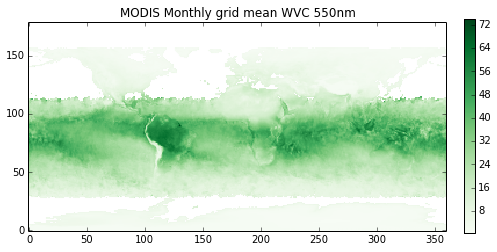

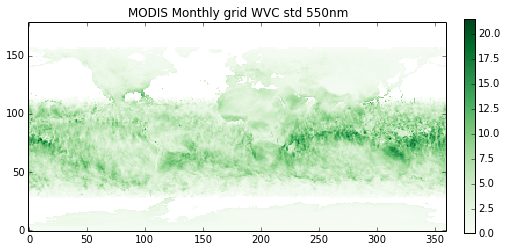

In [16]:
# load the MODIS Monthly WVC data
# use the "super combined" Aerosol dataset which uses both Deep Blue and Dark Target

import gdal
import glob
import numpy as np
import pdb
import matplotlib.pylab as plt
%matplotlib inline
import os

path = '/home/malapradej/Documents/PhD_UCL/Data/MODIS/Combined/M[OY]D08_M3.A2007001*.hdf'
fns = glob.glob(path)

dss = []
dssd = []

for fn in fns:
    g = gdal.Open(fn)

    if g is None:
        print "Problem opening file %s!" % fn
    else:
        pass#print "File %s opened fine" % fn

    subds = g.GetSubDatasets()

    selected_layers = [  "Water_Vapor_Near_Infrared_Clear_Mean_Mean", \
                       "Water_Vapor_Near_Infrared_Clear_Mean_Std"]
    
    data = {}
    
    scale_offset = {}

    file_template = 'HDF4_EOS:EOS_GRID:"%s":mod08:%s'
    
    for i, layer in enumerate ( selected_layers ):
        this_file = file_template % ( fn, layer )
        #print "Opening Layer %d: %s" % (i+1, this_file )
        g = gdal.Open ( this_file )
        if g is None:
            raise IOError
        meta = g.GetMetadata()
        scale_offset[layer] = (float(meta['scale_factor']), float(meta['add_offset']))
        data[layer] = g.ReadAsArray()
        #print "\t>>> Read %s!" % layer

    ds = data["Water_Vapor_Near_Infrared_Clear_Mean_Mean"]
    ds = np.ma.masked_equal(ds, -9999)
    scale = scale_offset["Water_Vapor_Near_Infrared_Clear_Mean_Mean"][0]
    offset = scale_offset["Water_Vapor_Near_Infrared_Clear_Mean_Mean"][1]
    ds = scale * (ds - offset)
    ds = ds * 10. # convert from cm to kg/m2
    dss.append(ds)
    
    ds = data["Water_Vapor_Near_Infrared_Clear_Mean_Std"]
    ds = np.ma.masked_equal(ds, -9999)
    scale = scale_offset["Water_Vapor_Near_Infrared_Clear_Mean_Std"][0]
    offset = scale_offset["Water_Vapor_Near_Infrared_Clear_Mean_Std"][1]
    ds = scale * (ds - offset)
    ds = ds * 10. # convert from cm to kg/m2
    dssd.append(ds)

    
dss = np.ma.array(dss)
#dss = np.array(dss)
dss_ave = np.ma.mean(dss, axis=0)

#pdb.set_trace()

dssd = np.ma.array(dssd)
#dssd = np.array(dssd)
dssd_ave = np.ma.mean(dssd, axis=0)

cmap = plt.cm.Greens
plt.figure(figsize=(8,8))
plt.imshow(dss_ave[::-1],interpolation='none',cmap=cmap, origin='lower')
plt.title('MODIS Monthly grid mean WVC 550nm')
plt.colorbar(fraction=0.024, pad=0.04)

cmap = plt.cm.Greens
plt.figure(figsize=(8,8))
plt.imshow(dssd_ave[::-1],interpolation='none',cmap=cmap, origin='lower')
plt.title('MODIS Monthly grid WVC std 550nm')
plt.colorbar(fraction=0.024, pad=0.04)

# tiff file name
fn = 'MODIS_WVC_combined_grid_monthly.tiff'
fn = os.path.join(os.path.dirname(path), fn)

# create a simple raster from array and save as tiff in equal area projection coords
cols = dss_ave.shape[1]
rows = dss_ave.shape[0]
x_ul, x_dim, rotx, y_ul, roty, y_dim = g.GetGeoTransform()
originX = x_ul
originY = y_ul
pixelWidth = x_dim
pixelHeight = y_dim

NODATA = -9999

driver = gdal.GetDriverByName('GTiff')
outRaster = driver.Create(fn, cols, rows, 2, gdal.GDT_Float32)
outRaster.SetGeoTransform((originX, pixelWidth, 0, originY, 0, pixelHeight))
outband1 = outRaster.GetRasterBand(1)
outband1.WriteArray(dss_ave.filled(NODATA))
outband1.SetNoDataValue(NODATA)
outband2 = outRaster.GetRasterBand(2)
outband2.WriteArray(dssd_ave.filled(NODATA))
outband2.SetNoDataValue(NODATA)
wkt = g.GetProjectionRef()
#outRasterSRS = osr.SpatialReference()
#outRasterSRS.ImportFromEPSG(4326)
outRaster.SetProjection(wkt)
outband1.FlushCache()
outband2.FlushCache()
outRaster = None

print 'Monthly mean WVC: %.3f' % np.ma.mean(dss_ave)
print 'Monthly std  WVC: %.3f' % np.ma.std(dssd_ave)


# ERA-Interim Daily WVC and press

Daily mean surface pressure: 965.853
Daily mean total colum wv: 17.188


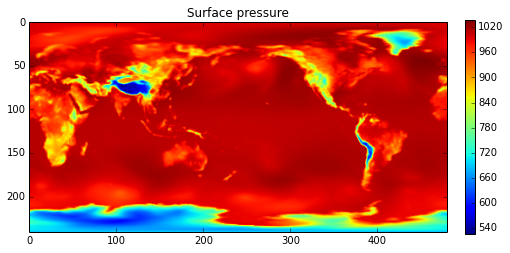

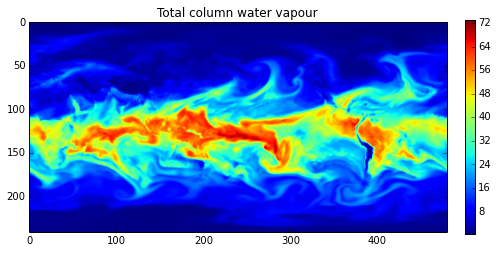

In [413]:
# now to get surface pressure from ERA-Interim dataset

# the dataset consists of 6 hourly estimates of surface pressure and total column water vapour
# at spatial resolution of 0.75 degrees and time in hours since 1900-01-01. This dataset below
# is for the month of Jan 2007. 124 6 hour estimates....
# pressure and water vapour values need scale and offset include same as MODIS above....
# time is in gregorian calendar in hours since 1900-01-01 00:00:00 (our midday obs is 938532)



import numpy as np
import matplotlib.pylab as plt
%matplotlib inline
import gdal
import os
import pdb
import osr
import time 
import datetime

# a function to calculate date from dataset hours format
date_1900 = lambda hrs: time.strftime('%Y-%m-%d %H:%M:%S', time.gmtime(hrs*60*60 - 2208988800))

# a function to calculate hrs from date input
def hrs_1900(y, mo, d, h, mi, s):
    since_1970 = (datetime.datetime(y,mo,d,h,mi,s) - datetime.datetime(1970,1,1)).total_seconds()/60/60
    since_1900 = since_1970 + 2208988800/60/60
    return since_1900
    
fn = '/home/malapradej/Documents/PhD_UCL/Data/ERA-Interim/netcdf-atls10-a562cefde8a29a7288fa0b8b7f9413f7-hzLg2h.nc'

selected_layers = ['sp', 'tcwv'] # surface pressure, total column water vapour

file_template = 'NETCDF:"%s":%s' 

data = []

meta_values = ['NETCDF_DIM_time_VALUES', '%s#add_offset', '%s#scale_factor', '%s#_FillValue', '%s#long_name']

for i, layer in enumerate ( selected_layers ):
    this_file = file_template % ( fn, layer )
    #print "Opening Layer %d: %s" % (i+1, this_file )
    g = gdal.Open ( this_file )
    if g is None:
        raise IOError
    meta = g.GetMetadata()
    scale = meta_values[2] % layer
    scale = float(meta[scale])
    offset = meta_values[1] % layer
    offset = float(meta[offset])
    dat = g.ReadAsArray()
    hrs_lst = meta[meta_values[0]]
    hrs_lst = np.array(hrs_lst[1:-1].split(',')).astype(np.float)
    idx = np.argmin(np.abs(hrs - hrs_lst))
    dat = dat[idx,:,:]
    fill = meta_values[3] % layer
    fill = int(meta[fill])
    dat = np.ma.masked_equal(dat, fill)
    dat = scale * dat + offset
    if layer == 'sp':
        dat /= 100. # convert to hPa
    plt.figure(figsize=(8,8))
    plt.imshow(dat)
    name = meta_values[4] % layer
    name = meta[name]
    plt.title(name)
    plt.colorbar(fraction=0.024, pad=0.04)
    #print "\t>>> Read %s!" % layer
    data.append(dat)

sp = data[0]
tcwv = data[1]

# tiff file name
path = os.path.dirname(fn)
fn = 'Era_interim_press_wvc.tiff'
fn = os.path.join(path, fn)

# create a simple raster from array and save as tiff in wgs84 coords
cols = g.RasterXSize
rows = g.RasterYSize
x_ul, x_dim, rotx, y_ul, roty, y_dim = g.GetGeoTransform()# (-0.375, 0.75, 0.0, 90.375, 0.0, -0.75)
x_ul -= 180 # correct for 360 to 180 lon range
originX = x_ul
originY = y_ul
pixelWidth = x_dim
pixelHeight = y_dim

# correct for the 0 to 360 lons to -180 to 180
sp = np.roll(sp, cols/2, axis=1)
tcwv = np.roll(tcwv, cols/2, axis=1)


#gdal.SetConfigOption('CENTER_LONG','0')

driver = gdal.GetDriverByName('GTiff')
outRaster = driver.Create(fn, cols, rows, 2, gdal.GDT_Float32)
outRaster.SetGeoTransform((originX, pixelWidth, rotx, originY, roty, pixelHeight))
outband1 = outRaster.GetRasterBand(1)
outband1.WriteArray(sp)
outband2 = outRaster.GetRasterBand(2)
outband2.WriteArray(tcwv)
outRasterSRS = osr.SpatialReference()
outRasterSRS.ImportFromEPSG(4326)
outRaster.SetProjection(outRasterSRS.ExportToWkt())
outband1.FlushCache()
outband2.FlushCache()
outRaster = None

print 'Daily mean surface pressure: %.3f' % np.nanmean(sp)
print 'Daily mean total colum wv: %.3f' % np.nanmean(tcwv)    


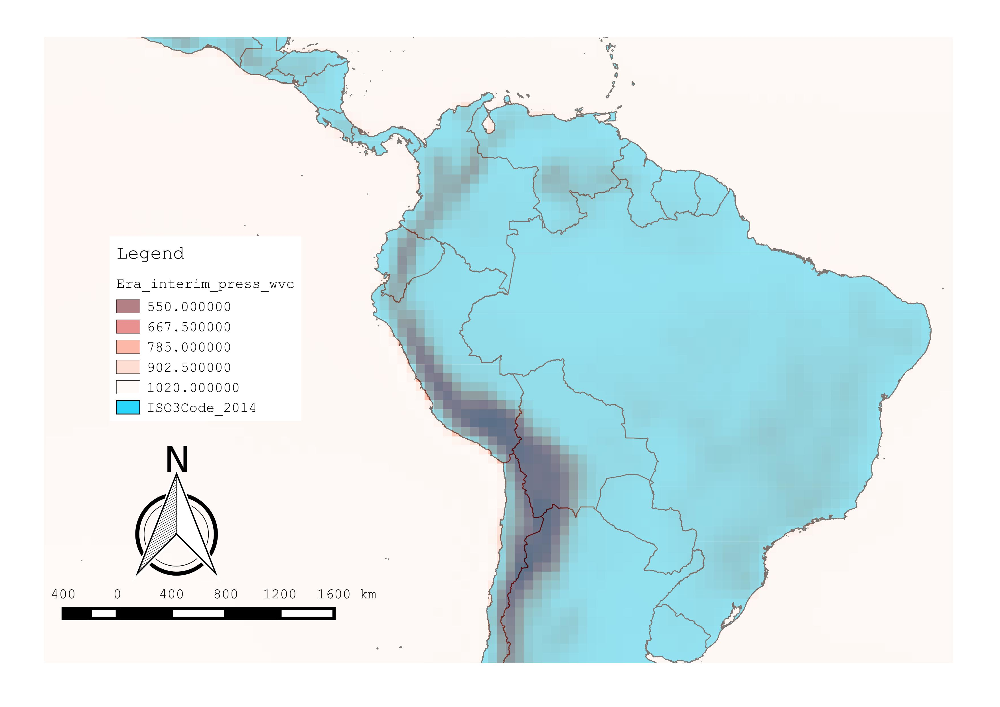

In [414]:
# load and plot the data for surface pressure
from wand.image import Image as WImage
img = WImage(filename='../../Data/ERA-Interim/image_sp.jpg')
img

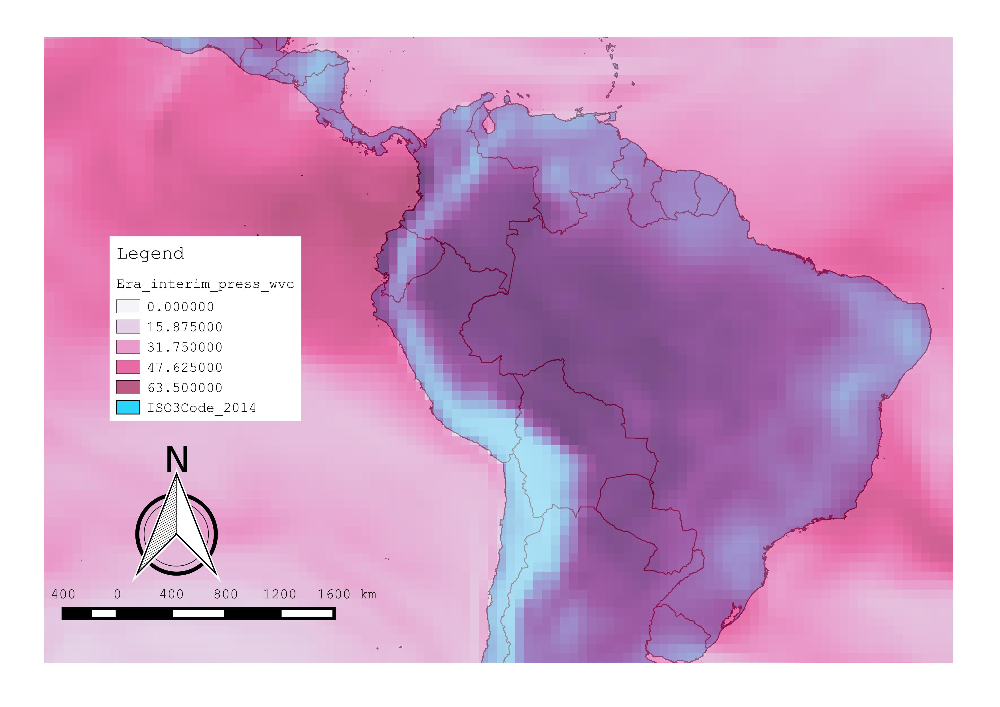

In [415]:
# load and plot the data for water vapour
from wand.image import Image as WImage
img = WImage(filename='../../Data/ERA-Interim/image_tcwv.jpg')
img

# Bayesian retrievals with priors from Datasets

In [2]:
# open the pickled dict of observations created before

import sys
import gdal
import os
from scipy import optimize
from scipy.interpolate import interp1d
import pickle
import numpy as np
import matplotlib.pylab as plt
%matplotlib inline
import pandas as pd
import pdb

# to range we need
wl_min = 680
wl_max = 755

# path to EPS file to read
e_fn = '/home/malapradej/Documents/PhD_UCL/Data/GOME-2/l1b/2007/01/GOME_xxx_1B_M02_20070125124939Z_20070125143057Z_R_O_20120209112017Z'

path = '/home/malapradej/Documents/PhD_UCL/Data/GOME-2/DASF'
base = os.path.splitext(e_fn)[0]
base = os.path.basename(base)
base = os.path.join(path, base)
ext =  '_EPS_QAd.p'
path = os.path.join(path, base + ext)

dic = pickle.load(open(path, 'rb'))

In [15]:
np.linalg.inv(H[0]).diagonal()

array([ -7.08294936e+00,  -1.26801475e-03,   5.07456777e+01,
         1.15604562e-05,   6.80944117e-05,   6.83958399e-05,
        -3.23105369e-02])

In [3]:
for r in np.array(dic['Ref_toa'])[ix]:
    plt.plot(r)

NameError: name 'ix' is not defined

Lat: 2.4091, Lon: -57.1616
(-57.161616, 2.409092)
solver success: True
cost: 1461.0160
sza: 45.178673, vza: 3.187964, raa: 17.362448, alt: 0.239 km
--------------------------------------------------
Prior parameters (mean, std)
clf: 0.1883, AOT: 0.2090, WVC: 39.0450 kg/m2, press:  979.3265 hPa
std: 0.0500, std: 0.0180, std:  5.8350 kg/m2, std:     10.0000 hPa
--------------------------------------------------
Retrieved parameters (mean, std)
clf: 0.1685, AOT: 0.2214, WVC: 74.6422 kg/m2, press: 1082.5265 hPa, a:   0.0366,   p: 0.8428, DASF: 0.2329
std: 0.0249, std: 0.0111, std:     nan kg/m2, std:      6.6541 hPa, std: 0.0010, std: 0.0042
--------------------------------------------------
Correlation matrix
[[ nan  nan  nan  nan  nan  nan  nan]
 [ nan  nan  nan  nan  nan  nan  nan]
 [ nan  nan  nan  nan  nan  nan  nan]
 [ nan  nan  nan  nan  nan  nan  nan]
 [ nan  nan  nan  nan  nan  nan  nan]
 [ nan  nan  nan  nan  nan  nan  nan]
 [ nan  nan  nan  nan  nan  nan  nan]]


/usr/local/lib/python2.7/dist-packages/IPython/kernel/__main__.py:310: OptimizeWarning: Unknown solver options: upper, lower


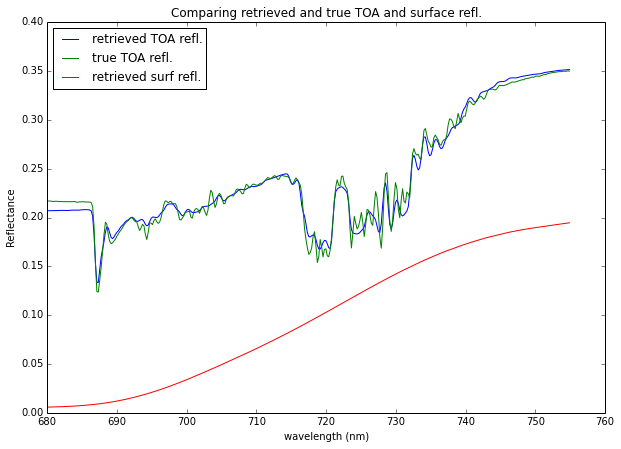

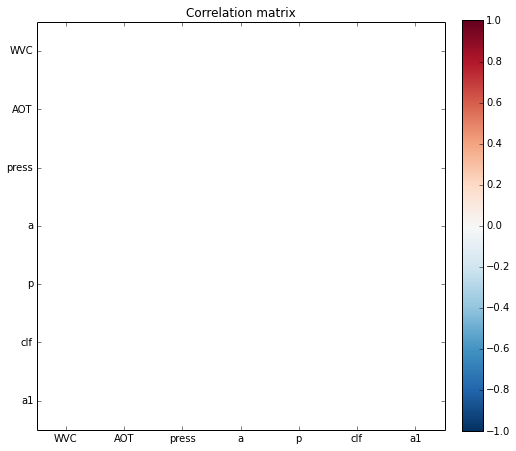

In [29]:
# select sequence number of obs

# select the obs number from this filtered list above
n = 13

# select obs which conform to this less than this clf
clf_thresh = 0.2

ix = np.where(np.array(dic['Cloud_frac']) < clf_thresh)[0]

def raa_fun(sol_azi, sat_azi):
    '''Function to calculate the relative azimuth angle'''
    dif = np.array(sat_azi) - np.array(sol_azi)
    dif = np.where(dif < 0., dif + 360., dif)
    dif = np.where(dif > 180., 360 - dif, dif)
    return dif

i = ix[n]

sza = dic['Sol_zen'][i]
vza = dic['Sat_zen'][i]
sat_azi = dic['Sat_azi'][i]
sol_azi = dic['Sol_azi'][i]
raa = raa_fun(sol_azi, sat_azi)
alt = dic['Alt'][i]/1000. # to km AMSL
toa_refl_gome = dic['Ref_toa'][i]
lam_gome = dic['Lam'][i]
clf_prior = dic['Cloud_frac'][i]

# load the emulator wavelengths
fns = '../../Data/LUT/lhd1000_valid_ap_realistic/21_15_19_0.50970436_0.07229065_16.37942169_1001.99633933_0.36659157_0.624668.p'
lam_emu = pickle.load(open(fns, 'rb'))['lam']

# print the lat and lon
lat = dic['Lat'][i]
lon = dic['Lon'][i]
print 'Lat: %.4f, Lon: %.4f' % (lat, lon)
print (lon, lat)


# Read in the raster datasets and get values at coordinate
# load SeaWifs AOT 5 year dataset as this is the only one with sufficient data over the Amazon to warrant inclusion
# January is the Amazon wet season which makes observations relatively difficult althoug Burning Aerosols can be 
# expected to be lower. Thus global average will be used in places with no AOD information.
# load ERA-interim WVC and press datasets of the day to start off
# test these first....

#lat, lon = (-1.5, -70.5)

# MODIS AOT daily
fn = '../../Data/MODIS/Combined/MODIS_AOT_combined_grid_day.tiff'

NODATA = -9999

src_ds=gdal.Open(fn)
gt=src_ds.GetGeoTransform()
rb1=src_ds.GetRasterBand(1)
rb2=src_ds.GetRasterBand(2)

px = int((lon - gt[0]) / gt[1]) #x pixel
py = int((lat - gt[3]) / gt[5]) #y pixel

AOT_prior=rb1.ReadAsArray(px,py,1,1)[0][0]
AOT_var=rb2.ReadAsArray(px,py,1,1)[0][0]

# MODIS AOT 8 day
if AOT_prior == -9999:
    fn = '../../Data/MODIS/Combined/MODIS_AOT_combined_grid_8_day.tiff'
    
    src_ds=gdal.Open(fn)
    gt=src_ds.GetGeoTransform()
    rb1=src_ds.GetRasterBand(1)
    rb2=src_ds.GetRasterBand(2)

    px = int((lon - gt[0]) / gt[1]) #x pixel
    py = int((lat - gt[3]) / gt[5]) #y pixel

    AOT_prior=rb1.ReadAsArray(px,py,1,1)[0][0]
    AOT_var=rb2.ReadAsArray(px,py,1,1)[0][0]
    
    # MODIS AOT Monthly
    if AOT_prior == -9999:
        fn = '../../Data/MODIS/Combined/MODIS_AOT_combined_grid_Monthly.tiff'

        src_ds=gdal.Open(fn)
        gt=src_ds.GetGeoTransform()
        rb1=src_ds.GetRasterBand(1)
        rb2=src_ds.GetRasterBand(2)

        px = int((lon - gt[0]) / gt[1]) #x pixel
        py = int((lat - gt[3]) / gt[5]) #y pixel

        AOT_prior=rb1.ReadAsArray(px,py,1,1)[0][0]
        AOT_var=rb2.ReadAsArray(px,py,1,1)[0][0]
        
        # Monthly average
        if AOT_prior == -9999:
            
            AOT_prior = 0.166
            AOT_var = 0.108

if AOT_var == 0.0:
    AOT_var = 0.108
    
AOT_var = AOT_var**2.


# # SeaWifs AOD
# fn = '../../Data/SeaWIFS/Aerosols/SeaWifs_AOT_combined_5_year.tiff'

# src_ds=gdal.Open(fn)
# gt=src_ds.GetGeoTransform()
# rb1=src_ds.GetRasterBand(1)
# rb2=src_ds.GetRasterBand(2)

# px = int((lon - gt[0]) / gt[1]) #x pixel
# py = int((lat - gt[3]) / gt[5]) #y pixel

# AOT_prior=rb1.ReadAsArray(px,py,1,1)[0][0]
# AOT_var=rb2.ReadAsArray(px,py,1,1)[0][0]**2.

# if np.isnan(AOT_prior):
#     AOT_prior = 0.05
#     AOT_var = 0.03**2.

# MODIS WVC daily
fn = '../../Data/MODIS/Combined/MODIS_WVC_combined_grid_day.tiff'

NODATA = -9999

src_ds=gdal.Open(fn)
gt=src_ds.GetGeoTransform()
rb1=src_ds.GetRasterBand(1)
rb2=src_ds.GetRasterBand(2)

px = int((lon - gt[0]) / gt[1]) #x pixel
py = int((lat - gt[3]) / gt[5]) #y pixel

WVC_prior=rb1.ReadAsArray(px,py,1,1)[0][0]
WVC_var=rb2.ReadAsArray(px,py,1,1)[0][0]

# MODIS WVC 8 day
if WVC_prior == -9999:
    fn = '../../Data/MODIS/Combined/MODIS_WVC_combined_grid_8_day.tiff'
    
    src_ds=gdal.Open(fn)
    gt=src_ds.GetGeoTransform()
    rb1=src_ds.GetRasterBand(1)
    rb2=src_ds.GetRasterBand(2)

    px = int((lon - gt[0]) / gt[1]) #x pixel
    py = int((lat - gt[3]) / gt[5]) #y pixel

    WVC_prior=rb1.ReadAsArray(px,py,1,1)[0][0]
    WVC_var=rb2.ReadAsArray(px,py,1,1)[0][0]
    
    # MODIS WVC Monthly
    if WVC_prior == -9999:
        fn = '../../Data/MODIS/Combined/MODIS_WVC_combined_grid_monthly.tiff'

        src_ds=gdal.Open(fn)
        gt=src_ds.GetGeoTransform()
        rb1=src_ds.GetRasterBand(1)
        rb2=src_ds.GetRasterBand(2)

        px = int((lon - gt[0]) / gt[1]) #x pixel
        py = int((lat - gt[3]) / gt[5]) #y pixel

        WVC_prior=rb1.ReadAsArray(px,py,1,1)[0][0]
        WVC_var=rb2.ReadAsArray(px,py,1,1)[0][0]

        # ERA-Interim press
        if WVC_prior == -9999:
            fn = '../../Data/ERA-Interim/Era_interim_press_wvc.tiff'

            src_ds=gdal.Open(fn)
            gt=src_ds.GetGeoTransform()
            #rb1=src_ds.GetRasterBand(2)
            rb2=src_ds.GetRasterBand(2)

            px = int((lon - gt[0]) / gt[1]) #x pixel
            py = int((lat - gt[3]) / gt[5]) #y pixel

            #press_prior=rb1.ReadAsArray(px,py,1,1)[0][0]
            WVC_prior=rb2.ReadAsArray(px,py,1,1)[0][0]
        
            # Monthly average
            if WVC_prior == -9999:

                WVC_prior = 19.39
                WVC_var = 3.21

WVC_var = WVC_var**2.



# ERA-Interim press
fn = '../../Data/ERA-Interim/Era_interim_press_wvc.tiff'

src_ds=gdal.Open(fn)
gt=src_ds.GetGeoTransform()
rb1=src_ds.GetRasterBand(1)
#rb2=src_ds.GetRasterBand(2)

px = int((lon - gt[0]) / gt[1]) #x pixel
py = int((lat - gt[3]) / gt[5]) #y pixel

press_prior=rb1.ReadAsArray(px,py,1,1)[0][0]
press_var = (10.0)**2

#WVC_prior=rb2.ReadAsArray(px,py,1,1)[0][0]


# priors variances are based on the following:
# MODIS AOD +-0.05 +-0.2*tau (Chu et al. 2002)
# MODIS WV std 2.2mm (Li, Muller & Cross, 2003)
# NCEP and ERA-Interim press unknown...
# FRESCO vs FRESCO+ clf std 0.023 (Tuinder et al 2010) but expected accuracy <10% (Valks et al 2013)


#AOT_prior = 0.13
#AOT_var = (0.04)**2
#WVC_prior = 47.99
#WVC_var = (10.0)**2
#press_prior = 1005.3
press_var = (10.0)**2
# clf_prior = 0.25
clf_var = (0.05)**2

# round to closest value

# AOT = dic['AOT']
# WVC = dic['WVC']
# press = dic['press']
# a = dic['a']
# p = dic['p']
szar = int(round(sza, -1))
vzar = int(round(vza, -1))
raas = range(0, 195, 15)
raar = min(raas, key=lambda x:abs(x-raa))

# get gome wavelength interval to correct range
toa_refl_gome = toa_refl_gome[np.logical_and(lam_gome > wl_min, lam_gome < wl_max)]
lam_gome = lam_gome[np.logical_and(lam_gome > wl_min, lam_gome < wl_max)]

# # add the uncorrelated noise
# use convention of SNR = expected signal / std of noise
snr = 1000 # see sources in previous WB

# import cloud PCA
h5_fn = 'cloud_sims.h5'
pca_red_df = pd.read_hdf(h5_fn, key='pca_red_edge')

pca_lam = np.array(pca_red_df.index)
pcas_ = pca_red_df.values.T

# interpolate to gome resolution
pcas = []
for pc in pcas_:
    pcas.append((interp1d(pca_lam, pc, kind='linear'))(lam_gome))
pcas = np.array(pcas)

import gp_emulator
h5_emu = '/home/malapradej/Documents/PhD_UCL/Data/LUT/libradtran_emulators.h5'
emu = gp_emulator.MultivariateEmulator(dump=h5_emu, model='toa_refl', sza=szar, vza=vzar, raa=raar)

import h5py
h5_mean = h5py.File('/home/malapradej/Documents/PhD_UCL/Data/LUT/mean_signal.h5', 'r')
grp = '%s_%s_%s' % (szar, vzar, raar)
grp = h5_mean[grp]
mean_toa_refl = grp['mean_toa_refl'][:]

def cost(paras, sza, vza, raa, alt, toa_refl_gome, lam_gome, lam_emu, pcas, snr, WVCe, WVCv, AOTe, AOTv,\
         presse, pressv, clfe, clfv):
    '''The cost function to minimize the log of the probabilities
    '''
    WVC = paras[0]
    AOT = paras[1]
    press = paras[2]
    a = paras[3]
    p = paras[4]
    clf = paras[5]
    a1 = paras[6]
    paras = (WVC, AOT, alt, press, a, p)
    toa_refl_emu = emu.predict(paras)[0] + mean_toa_refl
    # get refls to same wavelenghts
    from scipy.interpolate import interp1d
    toa_refl_pred = (interp1d(lam_emu, toa_refl_emu, kind='linear'))(lam_gome)
    a0 = 1. / (1. - clf)
    toa_refl_pred = 1. / a0 * (toa_refl_pred - a1 * pcas[0])
    # forward model J term. need to calculate variance
    sigvar = (toa_refl_gome/snr)**2.
    Jmod = np.sum((toa_refl_pred - toa_refl_gome)**2./sigvar)/len(toa_refl_pred)
    # WVC J term
    Jwvc = (WVC - WVCe)**2./WVCv
    # AOT J term
    Jaot = (AOT - AOTe)**2./AOTv
    # press J term
    Jpress = (press - presse)**2./pressv
    # clf J term
    Jclf = (clf - clfe)**2./clfv
    J = Jmod + Jwvc + Jaot + Jpress + Jclf
    return J

args = (szar, vzar, raar, alt, toa_refl_gome, lam_gome, lam_emu, pcas, snr, WVC_prior, WVC_var, AOT_prior, AOT_var,\
         press_prior, press_var, clf_prior, clf_var)
#guess = (36., 0.5, 770., 0.4, 0.4, 1.1, 30.) # wvc, aot, press, a, p, clf, a1
guess = (WVC_prior, AOT_prior, press_prior, 0.5, 0.5, clf_prior, 30.)
bounds = ((0., 80.), (0., 1.), (500., 1100.), (0., 1.), (0., 1.), (0., 1.), (0., 10000))
lower = (0., 0., 500., 0., 0., 1., 0.)
upper = (80., 1., 1100., 1., 1., 1000., 10000.)
solv_paras = optimize.minimize(cost,guess,jac=False,method='L-BFGS-B',\
                                args=args,bounds=bounds, options={'lower': lower, 'upper': upper, 'maxiter': 1000})  

# show difference between retrieved and true parameters and plot retrieved and true spectra
WVCr = solv_paras['x'][0]
AOTr = solv_paras['x'][1]
pressr = solv_paras['x'][2]
ar = solv_paras['x'][3]
pr = solv_paras['x'][4]
clfr = solv_paras['x'][5]
a0r = 1. / (1. - clfr)
a1r = solv_paras['x'][6]
err = solv_paras['fun']
succ = solv_paras['success']

surf_refl_fun = lambda a, p, w: a * w / (1. - p * w)
dasf_fun = lambda a, p: a / (1. - p)

# dasf_true = dasf_fun(a, p)
dasf_pred = dasf_fun(ar, pr)

# calculate the Hessian for the std of the posterior 
import numdifftools as nd
hes = nd.Hessian(cost, full_output=True, method='central')
x = (WVCr, AOTr, pressr, ar, pr, clfr, a1r)
args = (szar, vzar, raar, alt, toa_refl_gome, lam_gome, lam_emu, pcas, snr, WVC_prior, WVC_var, AOT_prior, AOT_var,\
         press_prior, press_var, clf_prior, clf_var)
H = hes(x, szar, vzar, raar, alt, toa_refl_gome, lam_gome, lam_emu, pcas, snr, WVC_prior, WVC_var, AOT_prior, AOT_var,\
         press_prior, press_var, clf_prior, clf_var)
Cov = np.linalg.inv(H[0])
# Cov = np.linalg.inv(-H[0])
post_std = np.sqrt(np.diag(Cov))
WVCs, AOTs, presss, ass, ps, clfs, a1s = post_std

# calculate the correlation matrix

# corr = np.corrcoef(Cov)

D = np.eye(7)*np.sqrt ( Cov.diagonal() )
R = np.linalg.inv ( D )
corr =  R.dot(Cov.dot(R))

print 'solver success: %s' % succ
print 'cost: %.4f' % err
print 'sza: %s, vza: %s, raa: %s, alt: %s km' % (sza, vza, raa, alt)
# print '-'*50
# print 'True parameters'
# print 'clf: %5.4f, AOT: %5.4f, WVC: %7.4f kg/m2, press: %9.4f hPa, a: %5.4f, p: %5.4f, DASF: %5.4f' % \
#         (clf, AOT, WVC, press, a, p, dasf_true)
print '-'*50
print 'Prior parameters (mean, std)'
print 'clf: %5.4f, AOT: %5.4f, WVC: %7.4f kg/m2, press: %9.4f hPa' % \
        (clf_prior, AOT_prior, WVC_prior, press_prior,)
print 'std: %5.4f, std: %5.4f, std: %7.4f kg/m2, std:   %9.4f hPa' % \
        (np.sqrt(clf_var), np.sqrt(AOT_var), np.sqrt(WVC_var), np.sqrt(press_var))
print '-'*50
print 'Retrieved parameters (mean, std)'
print 'clf: %5.4f, AOT: %5.4f, WVC: %7.4f kg/m2, press: %9.4f hPa, a:   %5.4f,   p: %5.4f, DASF: %5.4f' % \
    (clfr, AOTr, WVCr, pressr, ar, pr, dasf_pred)
print 'std: %5.4f, std: %5.4f, std: %7.4f kg/m2, std:   %9.4f hPa, std: %5.4f, std: %5.4f' % \
        (clfs, AOTs, WVCs, presss, ass, ps )
print '-'*50
#print solv_paras

# plot the spectra true and retrieved
toa_refl_pred = emu.predict((WVCr, AOTr, alt, pressr, ar, pr))[0] + mean_toa_refl
toa_refl_pred = (interp1d(lam_emu, toa_refl_pred, kind='linear'))(lam_gome)
toa_refl_pred = 1. / a0r * (toa_refl_pred - a1r * pcas[0])
plt.figure(figsize=(10,7))
plt.plot(lam_gome, toa_refl_pred, label='retrieved TOA refl.')
plt.plot(lam_gome, toa_refl_gome, label='true TOA refl.')
leafw = np.loadtxt('leaf_spectrum.txt')
lam_leaf = leafw[:,0]
leafw = leafw[:,1] + leafw[:,2]
w = (interp1d(lam_leaf, leafw, kind='linear'))(lam_gome)
surf_refl_retr = surf_refl_fun(ar, pr, w)
# surf_refl = surf_refl_fun(a, p, w)
plt.plot(lam_gome, surf_refl_retr, label='retrieved surf refl.')
# plt.plot(lam_gome, surf_refl, label='true surf refl.')
plt.title('Comparing retrieved and true TOA and surface refl.')
plt.legend(loc='best')
plt.xlabel('wavelength (nm)')
plt.ylabel('Reflectance')

# plot the correlation matrix and print values
plt.figure(figsize=(8,8))
plt.imshow(corr,interpolation='nearest', cmap=plt.cm.RdBu_r, vmax=1, vmin=-1)
plt.title('Correlation matrix')
plt.xticks(np.arange(0.,7.,1),['WVC', 'AOT', 'press', 'a', 'p', 'clf', 'a1'])
plt.yticks(np.arange(0.,7.,1),['WVC', 'AOT', 'press', 'a', 'p', 'clf', 'a1'])
plt.colorbar(fraction=0.046, pad=0.04)
print 'Correlation matrix'
print corr

In [24]:
AOT_var

0.0

In [19]:
H

(array([[  2.76424619e+00,  -1.92738882e+02,  -2.27305076e-02,
          -2.32848734e+03,  -4.59844383e+02,   2.03083829e+03,
          -1.91812529e+02],
        [ -1.92738882e+02,   2.64496444e+04,   3.68348534e+00,
           2.18501793e+05,   4.22941208e+04,  -2.08753829e+05,
           1.97013330e+04],
        [ -2.27305076e-02,   3.68348534e+00,   2.19292973e-02,
           2.80369559e+01,   6.55734581e-03,  -2.45933200e+01,
           2.27280830e+00],
        [ -2.32848734e+03,   2.18501793e+05,   2.80369559e+01,
           3.51481575e+06,   6.62747958e+05,  -2.43398491e+06,
           2.13461582e+05],
        [ -4.59844383e+02,   4.22941208e+04,   6.55734581e-03,
           6.62747958e+05,   1.40397247e+05,  -4.69040660e+05,
           4.15190264e+04],
        [  2.03083829e+03,  -2.08753829e+05,  -2.45933200e+01,
          -2.43398491e+06,  -4.69040660e+05,   1.99256064e+06,
          -1.82077896e+05],
        [ -1.91812529e+02,   1.97013330e+04,   2.27280830e+00,
           2.

In [93]:
np.corrcoef(Cov)

array([[ 1.        , -0.79891804, -0.64951822, -0.56144139, -0.84656152,
        -0.57022856, -0.47200311],
       [-0.79891804,  1.        ,  0.06199325, -0.04873351,  0.35624334,
        -0.03826081, -0.15290658],
       [-0.64951822,  0.06199325,  1.        ,  0.99384328,  0.95430022,
         0.99491277,  0.97679027],
       [-0.56144139, -0.04873351,  0.99384328,  1.        ,  0.91552067,
         0.99990357,  0.99447333],
       [-0.84656152,  0.35624334,  0.95430022,  0.91552067,  1.        ,
         0.91988614,  0.86874585],
       [-0.57022856, -0.03826081,  0.99491277,  0.99990357,  0.91988614,
         1.        ,  0.9933669 ],
       [-0.47200311, -0.15290658,  0.97679027,  0.99447333,  0.86874585,
         0.9933669 ,  1.        ]])

In [94]:
D = np.eye(7)*np.sqrt ( Cov.diagonal() )
R = np.linalg.inv ( D )
R.dot(Cov.dot(R))

array([[ 1.        , -0.54822712, -0.14856287,  0.13015299, -0.43660724,
         0.15741921,  0.36261994],
       [-0.54822712,  1.        , -0.01931227,  0.47826998, -0.32880989,
        -0.07850681, -0.39018191],
       [-0.14856287, -0.01931227,  1.        ,  0.40328913,  0.28246977,
         0.56140586,  0.48487256],
       [ 0.13015299,  0.47826998,  0.40328913,  1.        , -0.33239493,
         0.69632517,  0.48452778],
       [-0.43660724, -0.32880989,  0.28246977, -0.33239493,  1.        ,
         0.3396937 ,  0.4006457 ],
       [ 0.15741921, -0.07850681,  0.56140586,  0.69632517,  0.3396937 ,
         1.        ,  0.9431518 ],
       [ 0.36261994, -0.39018191,  0.48487256,  0.48452778,  0.4006457 ,
         0.9431518 ,  1.        ]])